In [2]:
import os
import numpy as np
import pandas as pd
import pypsa
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib.dates as mdates
import cartopy.crs as ccrs
import seaborn as sns
import warnings
import re
warnings.filterwarnings("ignore")

from matplotlib import cm
from matplotlib.ticker import ScalarFormatter
from datetime import datetime
from matplotlib.dates import date2num
from matplotlib.patches import Circle
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.colors import LogNorm
from matplotlib.patches import Patch
from matplotlib.ticker import FormatStrFormatter
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import ListedColormap

In [3]:
folder = "../networks/solved/"
scenario = "zero_2050"
mods = ["no", "real", "full", "max_fraction", "tau", "flex_share"]

# Build list of filenames in desired order
files = [f"{scenario}_{mod}_solved.nc" for mod in mods]

## Pie-map-plot: DSM Capacities

INFO:pypsa.io:Imported network zero_2050_real_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


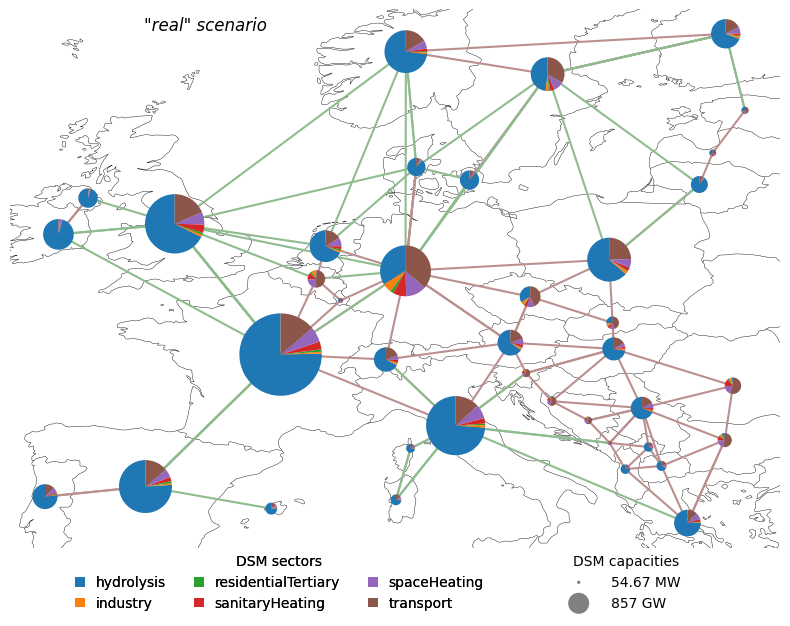

INFO:pypsa.io:Imported network zero_2050_full_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


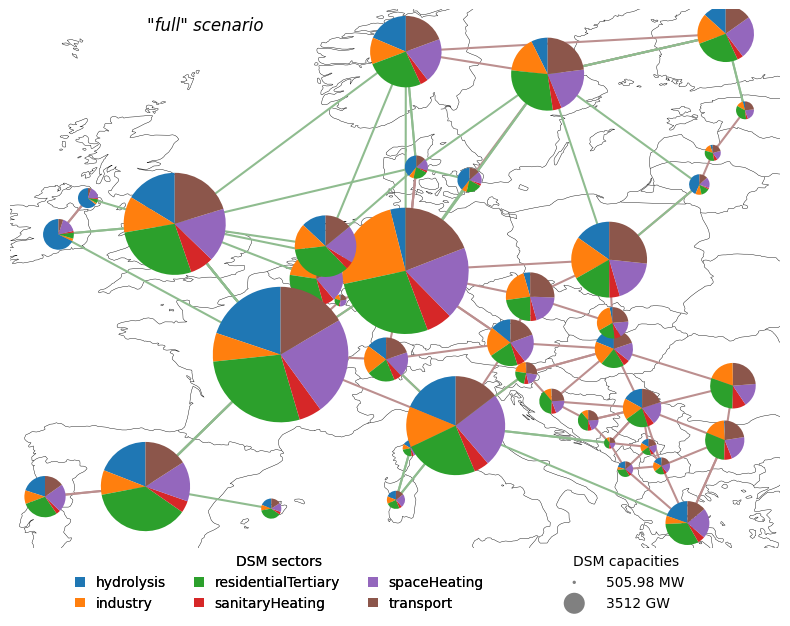

INFO:pypsa.io:Imported network zero_2050_max_fraction_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


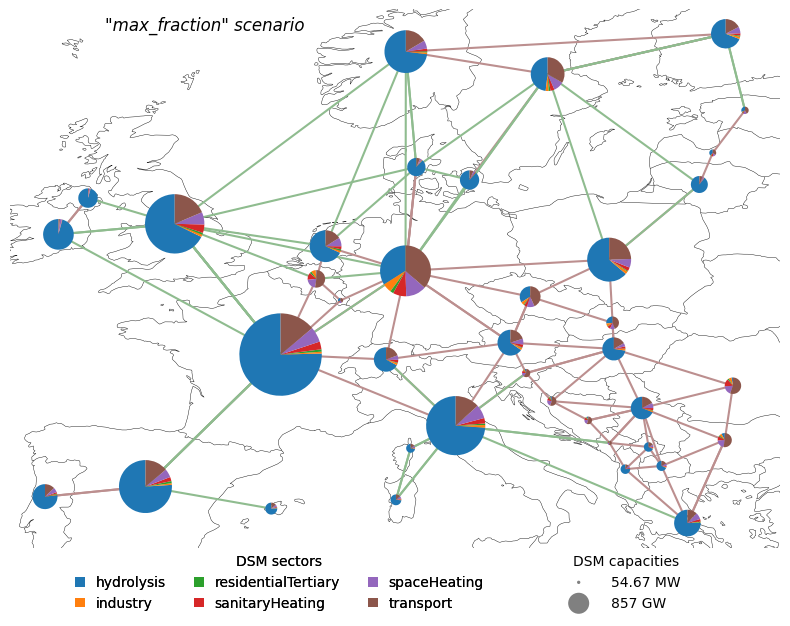

INFO:pypsa.io:Imported network zero_2050_tau_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


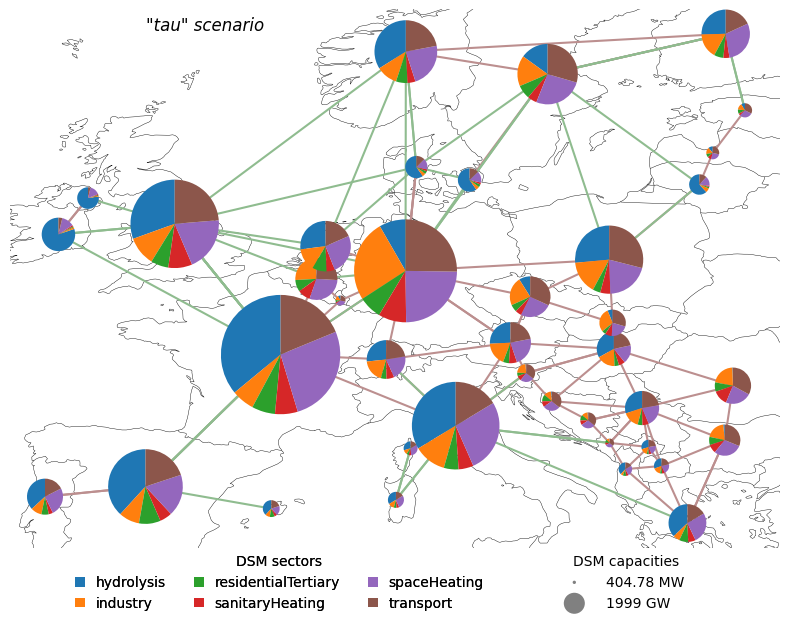

INFO:pypsa.io:Imported network zero_2050_flex_share_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


In [ ]:
for i, filename in enumerate(files):
    if "no" in filename:
        continue  # Skip the 'no' case
    path = os.path.join(folder, filename)
    if os.path.exists(path):
        n = pypsa.Network(path)

        # Assuming `n.stores` is your DataFrame
        df = n.stores
        # Extract the node and technology from the `bus` column
        df['node'] = df['bus'].str.split('_').str[0] + ' ' + df['bus'].str.split('_').str[1]
        df['technology'] = df['bus'].str.split('_').str[-1]
        # Group by node and technology, then sum p_nom_opt
        grouped = df.groupby(['node', 'technology'])['e_nom_opt'].sum()
        # Remove 'DSM' from node names in the grouped index
        grouped.index = grouped.index.set_levels(
            grouped.index.levels[0].str.replace(' DSM', '', regex=False),
            level=0
        )

        # Scaling storage units to universal level
        scaling_factor_storage = 3 / grouped.max()
        scaled_storage_sizes = grouped * scaling_factor_storage

        # Colors
        carrier_colors = {c: col for c, col in n.carriers["color"].items()}
        # Extended color list for new categories
        extended_colors = {
            "hydrolysis": "#1f77b4",  # A cool blue for hydrolysis
            "industry": "#ff7f0e",     # A vibrant orange for industry
            "residentialTertiary": "#2ca02c",  # A distinct green for residentialTertiary
            "sanitaryHeating": "#d62728",  # A strong red for sanitaryHeating
            "spaceHeating": "#9467bd",  # A purple for spaceHeating
            "transport": "#8c564b",  # A brown for transport
        }
        # Updating the carrier colors with the new extended list
        carrier_colors.update(extended_colors)

        fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

        # Plot with storage unit sizes at buses
        n.plot(ax=ax,
               bus_sizes=scaled_storage_sizes,
               bus_colors=carrier_colors #n.carriers.color,
        )

        # Legend for storage unit capacities
        sizes = [0.01,
                 0.4]
        labels = [f'{grouped.min():.2f} MW', f'{grouped.max() * 1e-3:.0f} GW']

        pypsa.plot.add_legend_circles(ax, sizes, labels, srid=4326, patch_kw=dict(facecolor='grey'), legend_kw={
            'loc': 'center',
            'bbox_to_anchor': (0.8, -0.065), #side: (1.15, 0.35) #lower: (0.8, -0.065)
            'title': 'DSM capacities',
            'frameon': False,
            'alignment': 'center',
        })

        pypsa.plot.add_legend_patches(ax, colors=list(extended_colors.values()), labels=list(extended_colors.keys()), patch_kw={}, legend_kw={
            'loc': 'center',
            'bbox_to_anchor': (0.35, -0.065), #side: (1.15, 0.65) #lower: (0.35, -0.065)
            'title': 'DSM sectors',
            'alignment': 'center',
            'frameon': False,
            'handlelength': 0.7, 
            'ncol': 3 #side: 1 #lower: 3 
        })

        ax.text(
            -0.5, 63,
            f'"{mods[i]}" scenario',
            style='oblique',
            fontsize=12,
            ha='center',
            va='center',
            transform=ccrs.PlateCarree()
        )

        plt.tight_layout()
        plt.savefig(f'../figures/lower/pie-map_DSM_caps_{filename}.pdf', bbox_inches='tight') #side: '../figures/pie-map_DSM_caps_{filename}.pdf' #lower: '../figures/lower/pie-map_DSM_caps_{filename}.pdf'
        plt.show()
    else:
        print(f"File not found: {filename}")

## Pie-map-plots: Storage Capacities

INFO:pypsa.io:Imported network zero_2050_no_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


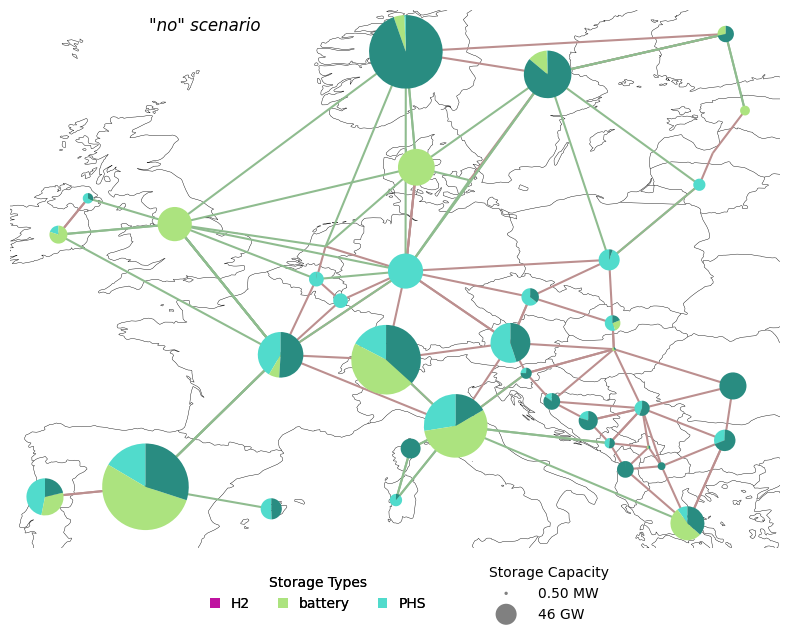

INFO:pypsa.io:Imported network zero_2050_real_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


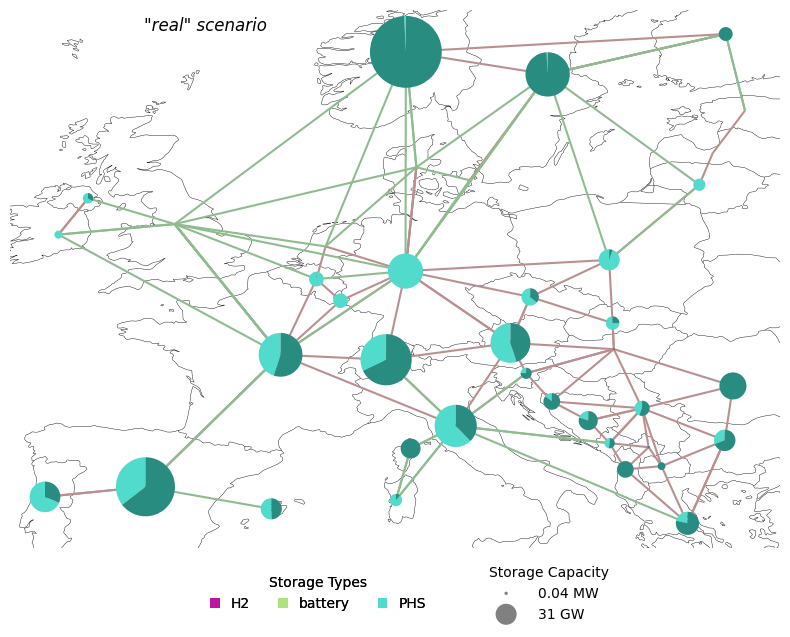

INFO:pypsa.io:Imported network zero_2050_full_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


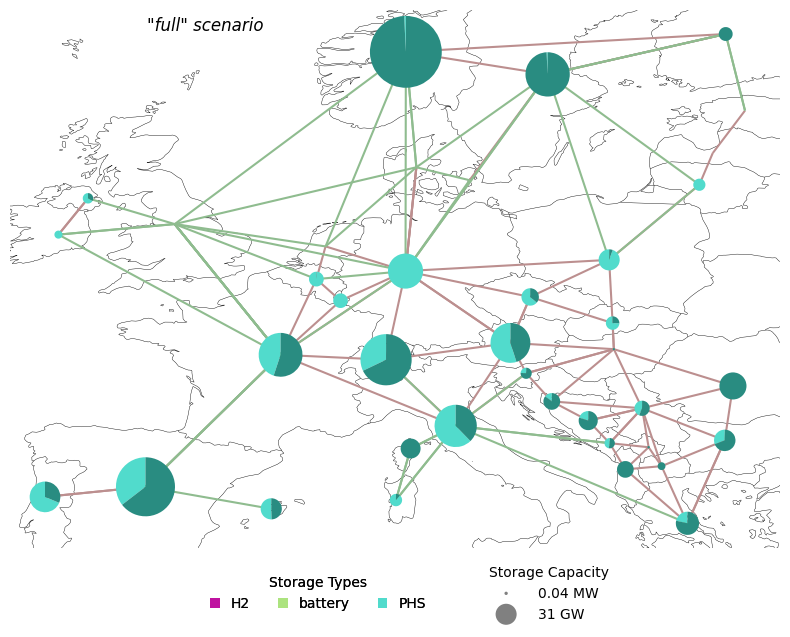

INFO:pypsa.io:Imported network zero_2050_max_fraction_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


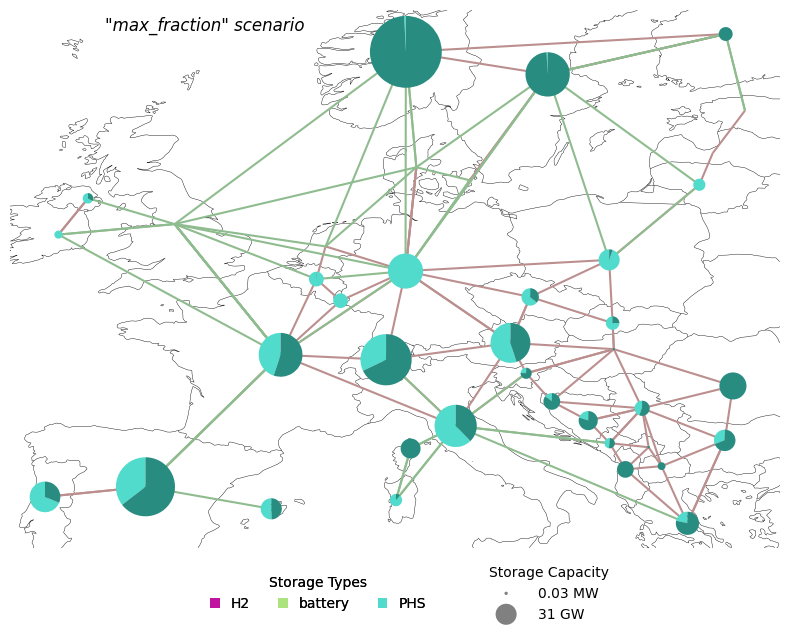

INFO:pypsa.io:Imported network zero_2050_tau_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


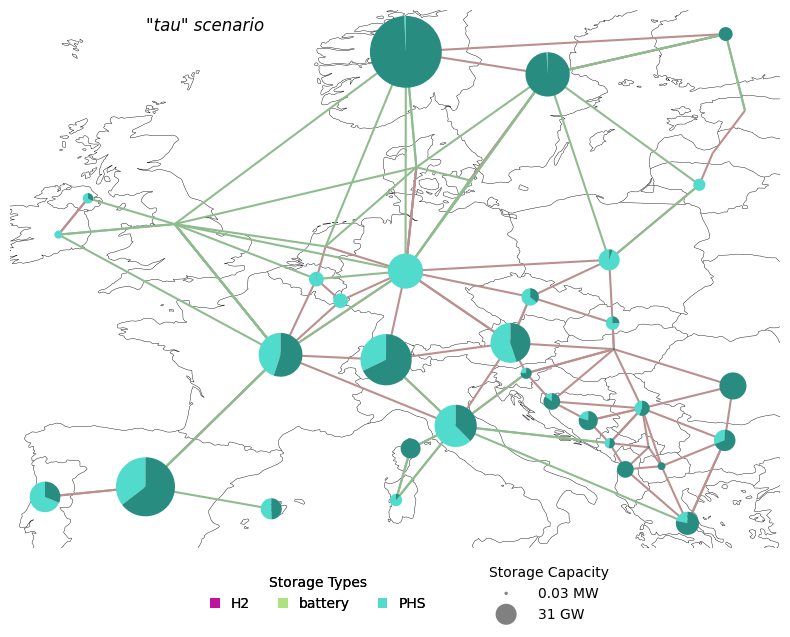

INFO:pypsa.io:Imported network zero_2050_flex_share_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


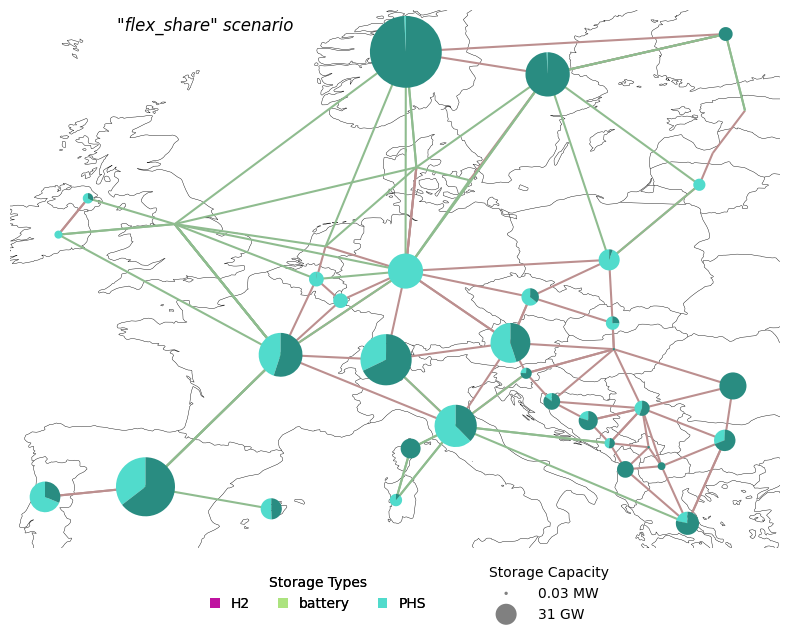

In [3]:
for i, filename in enumerate(files):
    path = os.path.join(folder, filename)
    if os.path.exists(path):
        n = pypsa.Network(path)
        
        # Ensure p_nom_opt exists for storage_units
        if n.storage_units.empty or n.storage_units.p_nom_opt.isnull().all():
            print(f"No storage data found in {filename}")
            continue

        # Scaling storage units to universal level
        scaling_factor_storage = 3 / n.storage_units.groupby(['bus', 'carrier']).p_nom_opt.sum().max()
        scaled_storage_sizes = n.storage_units.groupby(['bus', 'carrier']).p_nom_opt.sum() * scaling_factor_storage

        fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

        # Plot with storage unit sizes at buses
        n.plot(ax=ax,
               bus_sizes=scaled_storage_sizes,
               bus_colors=n.carriers.color,
        )

        # Legend for storage unit capacities
        grouped_storage = n.storage_units.groupby(['bus']).p_nom_opt.sum()
        sizes = [0.01,
                 0.4]
        labels = [f'{grouped_storage.min():.2f} MW', f'{grouped_storage.max() * 1e-3:.0f} GW']
        
        pypsa.plot.add_legend_circles(ax, sizes, labels, srid=4326, patch_kw=dict(facecolor='grey'), legend_kw={
            'loc': 'center',
            'bbox_to_anchor': (0.7, -0.085),
            'title': 'Storage Capacity',
            'frameon': False,
            'alignment': 'center',
        })

        selected = n.carriers.color.loc[["H2", "battery", "PHS"]]
        pypsa.plot.add_legend_patches(ax, colors=selected .values, labels=selected.index, patch_kw={}, legend_kw={
            'loc': 'center',
            'bbox_to_anchor': (0.4, -0.085),
            'title': 'Storage Types',
            'alignment': 'center',
            'frameon': False,
            'handlelength': 0.7,
            'ncol': 3
        })

        ax.text(
            -0.5, 63,
            f'"{mods[i]}" scenario',
            style='oblique',
            fontsize=12,
            ha='center',
            va='center',
            transform=ccrs.PlateCarree()
        )

        plt.tight_layout()
        plt.savefig(f'../figures/pie-map_storage_caps_{filename}.pdf', bbox_inches='tight')
        plt.show()
    else:
        print(f"File not found: {filename}")


## Pie-map plots: Generation Capacities

INFO:pypsa.io:Imported network zero_2050_no_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network zero_2050_real_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_full_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_max_fraction_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_tau_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_flex_share_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


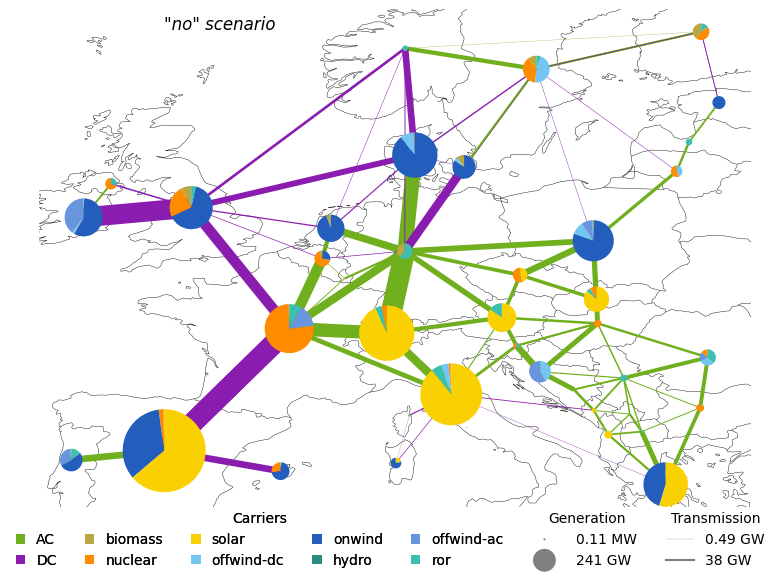

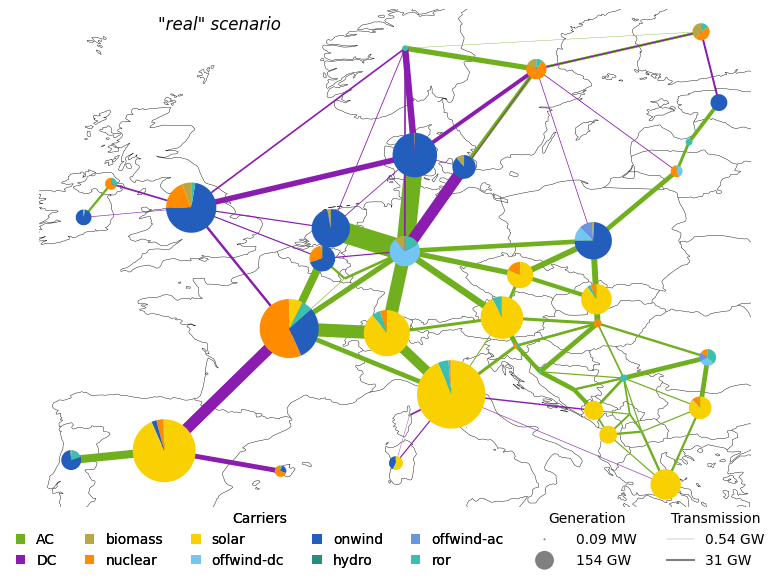

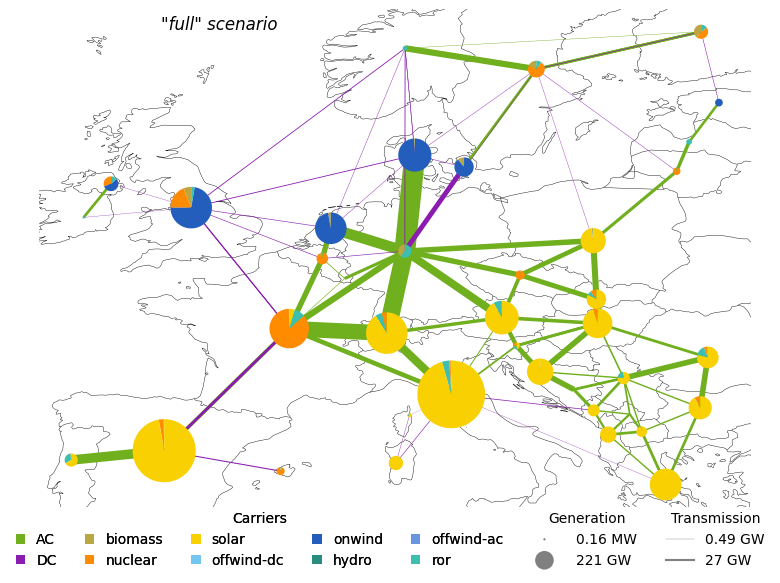

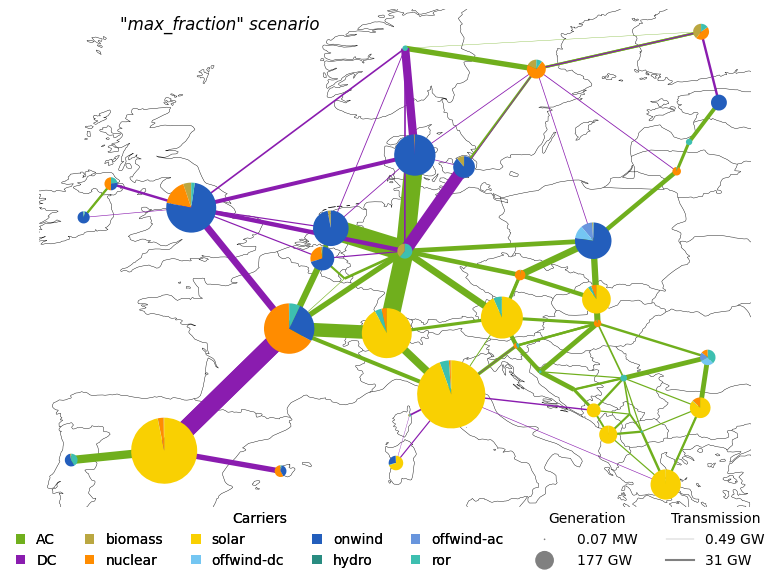

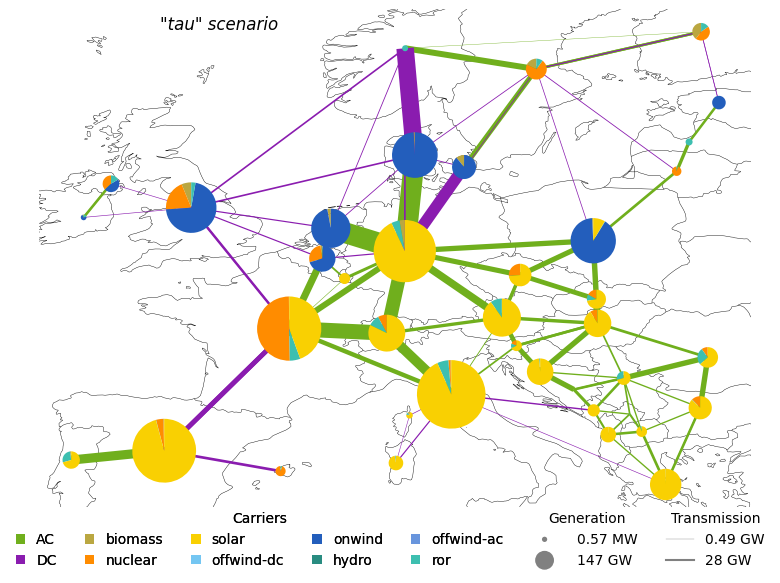

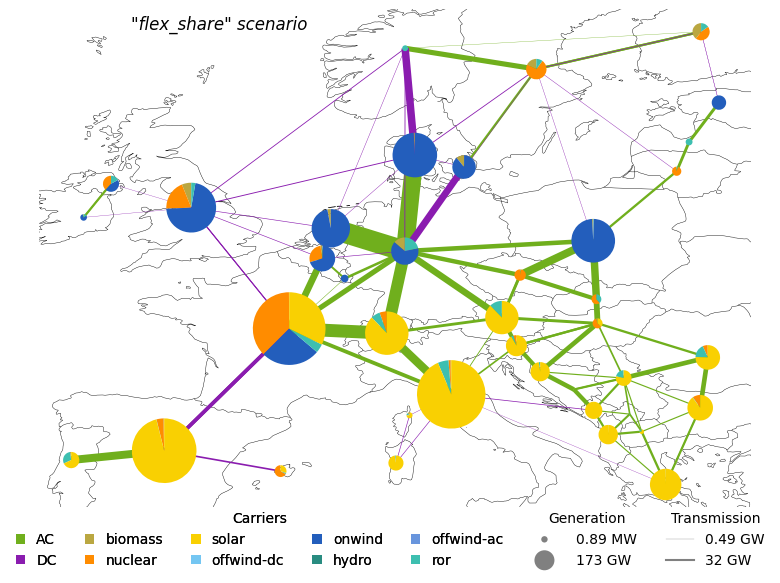

In [3]:
# Loop through and load/plot each one
for i, filename in enumerate(files):
    path = os.path.join(folder, filename)
    if os.path.exists(path):  # Optional: skip if file is missing
        n = pypsa.Network(path)
        
        # Scaling everything to universal level
        scaling_factor = 3 / n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().max()
        scaled_bus_sizes = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum() * scaling_factor
        scaling_factor_lines = 15 / n.lines.s_nom_opt.max()
        scaled_line_sizes = n.lines.s_nom_opt * scaling_factor_lines
        scaling_factor_links = 15 / n.links.p_nom_opt.max()
        scaled_link_sizes = n.links.p_nom_opt * scaling_factor_links

        fig, ax = plt.subplots(subplot_kw={"projection":ccrs.PlateCarree()}, figsize=(8, 8))
        n.plot(ax=ax,
            line_widths=n.lines.s_nom_opt*scaling_factor_lines, line_colors=n.carriers.color["AC"], 
            link_widths=n.links.p_nom_opt*scaling_factor_links, link_colors=n.carriers.color["DC"],
            bus_sizes=n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()*scaling_factor,
            bus_colors=n.carriers.color,
        )
        # Define sizes and labels for the legend
        sizes = [n.generators.groupby(['bus']).p_nom_opt.sum().min()*scaling_factor*2e3, n.generators.groupby(['bus']).p_nom_opt.sum().max()*scaling_factor/10]
        labels = [f'{n.generators.groupby(['bus']).p_nom_opt.sum().min():.2f} MW', f'{n.generators.groupby(['bus']).p_nom_opt.sum().max()*1e-3:.0f} GW']
        transmission_sizes = [n.lines.s_nom_opt.min()*scaling_factor_lines, n.lines.s_nom_opt.max()*scaling_factor_lines/10]
        transmission_labels = [f'{n.lines.s_nom_opt.min()*1e-3:.2f} GW', f'{n.lines.s_nom_opt.max()*1e-3:.0f} GW']
        pypsa.plot.add_legend_circles(ax, sizes, labels, srid=4326, patch_kw=dict(facecolor='grey'), legend_kw={
            'loc': 'center',  # Relative position inside the legend box
            'bbox_to_anchor': (0.77, -0.065), #side: (1.1, 0.25) #lower: (0.35, -0.065)
            #'title': 'Generation and Transmission Capacity',
            'frameon': False,
            'alignment':'center',
            'title': 'Generation',
        })
        pypsa.plot.add_legend_lines(ax, transmission_sizes, transmission_labels, patch_kw=dict(color='grey'), legend_kw={
            'loc': 'center',  # Relative position inside the legend box
            'bbox_to_anchor': (0.95, -0.065), #side: (1.1, 0.1) #lower: (0.35, -0.065)
            #'title': 'Transmission Capacity',
            'frameon': False,
            'alignment':'center',
            'title': 'Transmission',
        })

        valid_carriers = pd.Series({
            "AC": "#70af1d",
            "DC": "#8a1caf",
            "biomass": "#baa741",
            "nuclear": "#ff8c00",
            "solar": "#f9d002",
            "offwind-dc": "#74c6f2",
            "onwind": "#235ebc",
            "hydro": "#298c81",
            "offwind-ac": "#6895dd",
            "ror": "#3dbfb0"
        })
        pypsa.plot.add_legend_patches(ax, colors=valid_carriers.values, labels=valid_carriers.index, patch_kw={}, legend_kw={
        'loc': 'center',  
        'bbox_to_anchor': (0.31, -0.065), #side: (1.1, 0.65) #lower: (0.35, -0.065)
        'title': 'Carriers',
        'alignment':'center',
        'frameon': False,
        'handlelength': 0.7,
        # 'title_fontsize': 'small', 
        # 'fontsize': 'small',
        'ncol': 5 #side:1 #lower: 5
        })

        ax.text(
            -0.5, 63,  # Example longitude, latitude
            f'"{mods[i]}" scenario', 
            style='oblique',
            fontsize=12,
            ha='center',  # horizontal alignment: 'center', 'left', 'right'
            va='center',  # vertical alignment: 'center', 'top', 'bottom', etc.
            transform=ccrs.PlateCarree()
        )

        plt.tight_layout()
        # Show the plot
        plt.savefig(f'../figures/lower/pie-map_generation_caps_{filename}.pdf', bbox_inches='tight') #side:'../figures/pie-map_generation_caps_{filename}.pdf' #lower:'../figures/lower/pie-map_generation_caps_{filename}.pdf'
        #plt.close()
        #plt.show()
    else:
        print(f"File not found: {filename}")

## Pie-map plots: Load Coverage

In [4]:
def analyze_load_coverage(n, node_name):
    """
    Analyze how the load at a specific node is covered by different components.
    
    Parameters:
    -----------
    n : pypsa.Network
        The solved PyPSA network
    node_name : str
        The name of the node to analyze
    
    Returns:
    --------
    dict
        Dictionary with contribution of each source to load coverage
    """
    snapshots = n.snapshots
    load_at_node = n.loads_t.p_set[node_name].sum()
    
    # Skip nodes with no load
    if load_at_node == 0:
        return {}
    
    # Collect all potential sources
    sources = {
        'Generation': 0,
        'Storage_discharge': 0,
        'Imports': 0,
        'DSM_up': 0,
    }
    
    # Collect all sinks (besides load)
    sinks = {
        'Storage_charging': 0,
        'Exports': 0,
        'DSM_down': 0,
        'Losses': 0,
    }
    
    # 1. Generation from generators
    if hasattr(n, 'generators'):
        gens_at_node = n.generators[n.generators.bus == node_name].index
        if len(gens_at_node) > 0:
            sources['Generation'] = n.generators_t.p[gens_at_node].sum().sum()
    
    # 2. Storage units (discharge as source, charge as sink)
    if hasattr(n, 'storage_units'):
        storage_at_node = n.storage_units[n.storage_units.bus == node_name].index
        if len(storage_at_node) > 0:
            # Positive values are discharge (source)
            storage_p = n.storage_units_t.p[storage_at_node]
            sources['Storage_discharge'] = storage_p[storage_p > 0].sum().sum()
            sinks['Storage_charging'] = -storage_p[storage_p < 0].sum().sum()
    
    # 3. Store (similar to storage units)
    if hasattr(n, 'stores'):
        stores_at_node = n.stores[n.stores.bus == node_name].index
        if len(stores_at_node) > 0:
            # For stores, we need to look at the connected links
            for store in stores_at_node:
                store_links = n.links[n.links.bus0 == store].index
                for link in store_links:
                    if n.links.at[link, 'bus1'] == node_name:
                        # This is discharge
                        sources['Storage_discharge'] += n.links_t.p0[link][n.links_t.p0[link] > 0].sum()
                    
                store_links = n.links[n.links.bus1 == store].index
                for link in store_links:
                    if n.links.at[link, 'bus0'] == node_name:
                        # This is charging
                        sinks['Storage_charging'] += n.links_t.p0[link][n.links_t.p0[link] > 0].sum()
    
    # 4. Imports and exports through lines and links
    # For lines
    if hasattr(n, 'lines'):
        import_lines = n.lines[n.lines.bus1 == node_name].index
        export_lines = n.lines[n.lines.bus0 == node_name].index
        
        for line in import_lines:
            imports = n.lines_t.p0[line][n.lines_t.p0[line] > 0].sum()
            sources['Imports'] += imports
        
        for line in export_lines:
            exports = n.lines_t.p0[line][n.lines_t.p0[line] > 0].sum()
            sinks['Exports'] += exports
    
    # For links (directional connections)
    if hasattr(n, 'links'):
        import_links = n.links[n.links.bus1 == node_name].index
        export_links = n.links[n.links.bus0 == node_name].index
        
        for link in import_links:
            if n.links.at[link, 'bus0'] != node_name:  # Ensure it's not a storage link
                imports = n.links_t.p0[link][n.links_t.p0[link] > 0].sum()
                sources['Imports'] += imports
        
        for link in export_links:
            if n.links.at[link, 'bus1'] != node_name:  # Ensure it's not a storage link
                exports = n.links_t.p0[link][n.links_t.p0[link] > 0].sum()
                sinks['Exports'] += exports
    
    # 5. DSM (if present)
    if hasattr(n, 'links'):
        dsm_links = n.links[n.links.index.str.contains('DSM') & 
                             ((n.links.bus0 == node_name) | (n.links.bus1 == node_name))].index
        
        for link in dsm_links:
            # Charging = load increase = source (could be seen either way)
            sources['DSM_up'] += n.links_t.p0[link][n.links_t.p0[link] > 0].sum() #imports
            # Discharging = load decrease = sink
            sinks['DSM_down'] += n.links_t.p0[link][n.links_t.p0[link] < 0].sum()
    
    # Calculate total inflow
    total_inflow = sum(sources.values())
    
    # Calculate total outflow excluding load
    total_outflow_excl_load = sum(sinks.values())
    
    # Calculate losses (if any)
    loss = total_inflow - load_at_node - total_outflow_excl_load
    if loss > 0:
        sinks['Losses'] = loss
    
    # Calculate the proportion each source contributes to load
    load_coverage = {}
    if total_inflow > 0:
        load_proportion = load_at_node / total_inflow
        for source, value in sources.items():
            load_coverage[source] = value * load_proportion
    
    return load_coverage

def create_load_coverage_dataframe(n):
    """
    Create a DataFrame with load coverage for all nodes.
    
    Parameters:
    -----------
    n : pypsa.Network
        The solved PyPSA network
        
    Returns:
    --------
    pandas.DataFrame
        DataFrame with columns 'bus', 'carrier', and 'value'
    """
    # Get all bus names from the network
    all_buses = n.buses.index
    # Filter out those containing 'DSM'
    non_dsm_buses = [bus for bus in all_buses if 'DSM' not in bus]
    
    # Create empty lists to store data
    bus_list = []
    carrier_list = []
    value_list = []
    
    # Analyze each bus
    for node_name in non_dsm_buses:
        # Try to get carrier from the bus attributes, otherwise leave empty
        try:
            carrier = n.buses.at[node_name, 'carrier']
        except:
            carrier = ''
        
        # Get load coverage for this node
        load_coverage = analyze_load_coverage(n, node_name)
        
        # Skip nodes with no load coverage (no load)
        if not load_coverage:
            continue
        
        # Add each source contribution to the lists
        for source, value in load_coverage.items():
            bus_list.append(node_name)
            carrier_list.append(source)
            value_list.append(value)
    
    # Create DataFrame
    df = pd.DataFrame({
        'bus': bus_list,
        'carrier': carrier_list,
        'value': value_list
    })
    
    return df

# # Example usage
# # n = pypsa.Network('your_network.nc')
# df = create_load_coverage_dataframe(n)
# df = df.set_index(['bus', 'carrier'])
# df = df.sort_index()
# series = df["value"]

INFO:pypsa.io:Imported network zero_2050_no_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network zero_2050_real_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_full_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_max_fraction_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_tau_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_flex_share_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


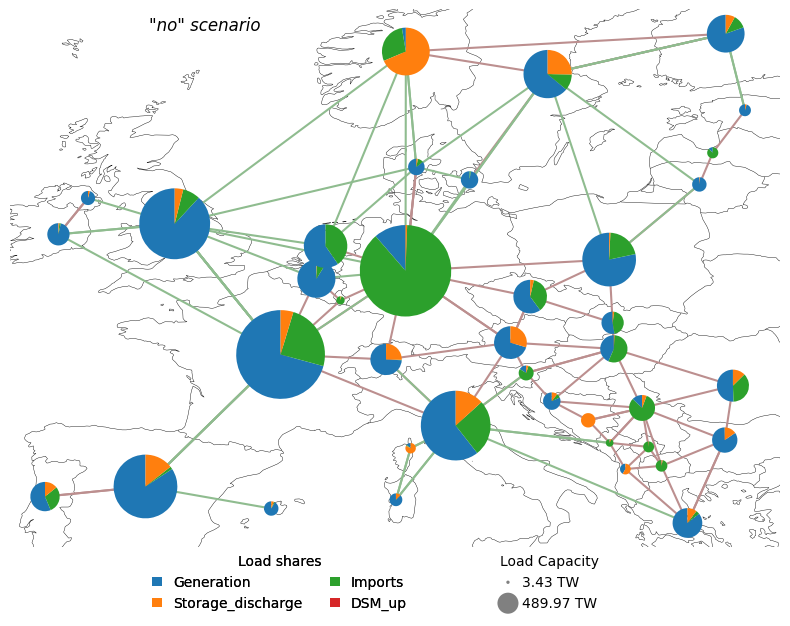

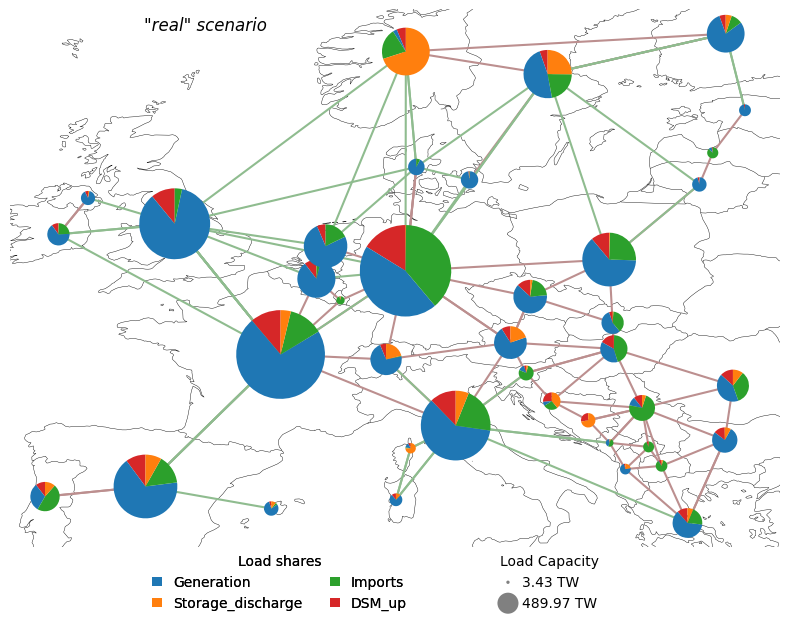

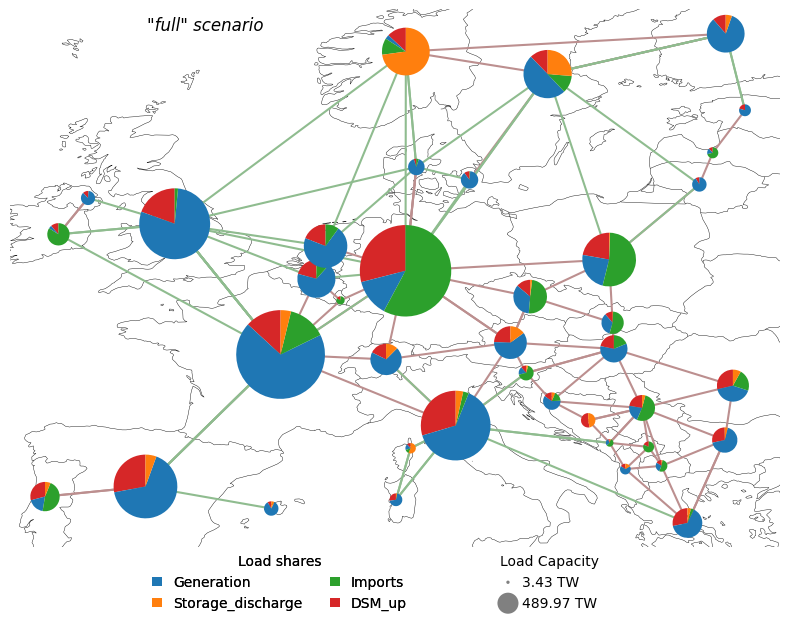

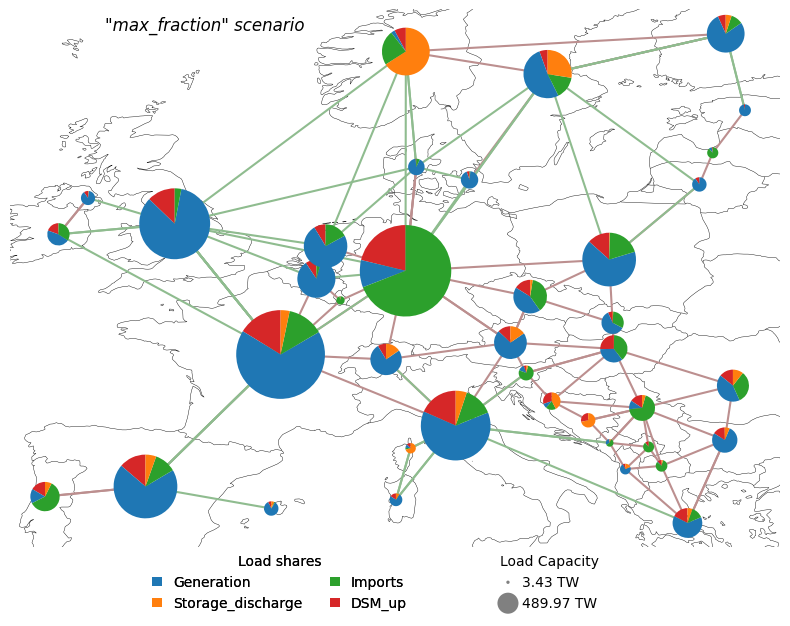

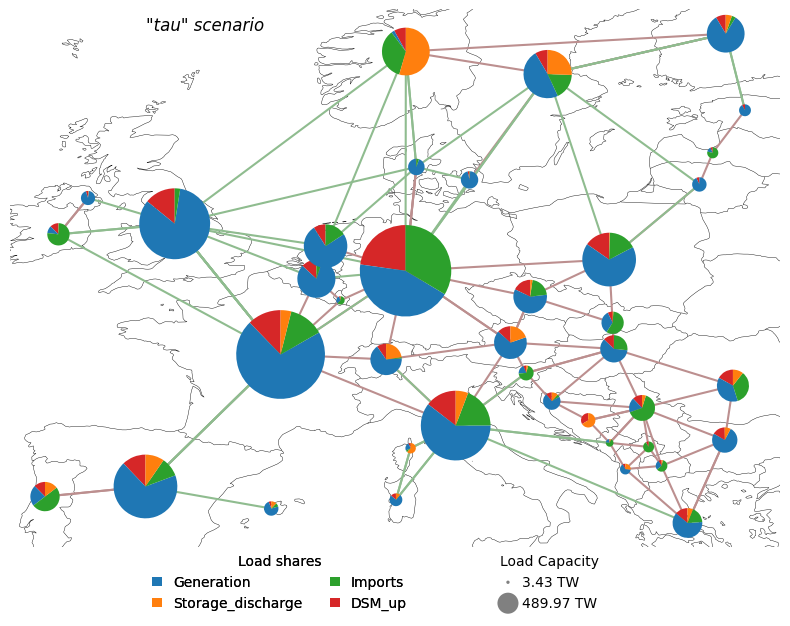

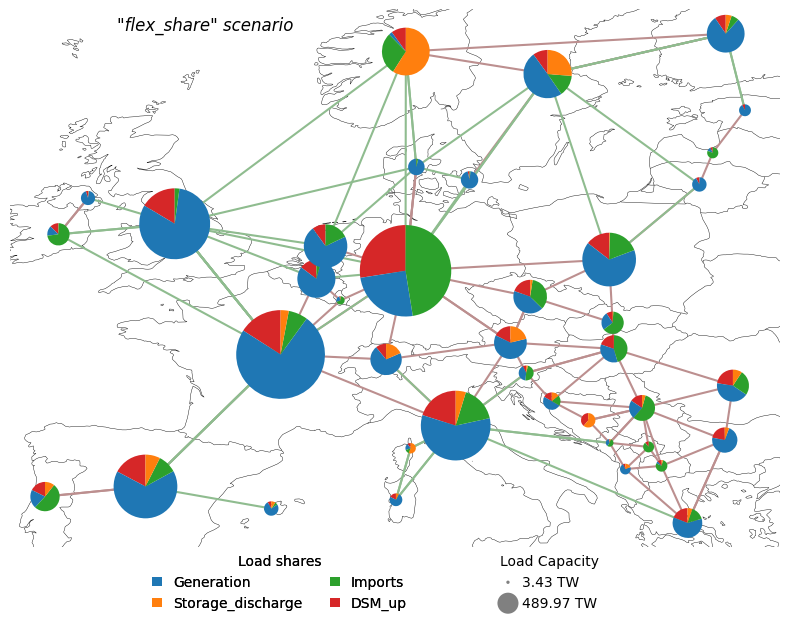

In [5]:
for i, filename in enumerate(files):
    path = os.path.join(folder, filename)
    if os.path.exists(path):
        n = pypsa.Network(path)
        
        # Ensure p_nom_opt exists for storage_units
        if n.storage_units.empty or n.storage_units.p_nom_opt.isnull().all():
            print(f"No storage data found in {filename}")
            continue
        
        df = create_load_coverage_dataframe(n)
        df = df.set_index(['bus', 'carrier'])
        df = df.sort_index()
        series = df["value"]

        source_colors = {
            'Generation': '#1F77B4',      # Blue
            'Storage_discharge': '#FF7F0E',  # Orange
            'Imports': '#2CA02C',         # Green
            'DSM_up': '#D62728'           # Red
        }
        fig, ax = plt.subplots(subplot_kw={"projection":ccrs.PlateCarree()}, figsize=(8, 8))
        n.plot(ax=ax,
                    bus_sizes=series*1e-8,
                    bus_colors=source_colors,
                )

        # Legend for storage unit capacities
        grouped_storage = df.groupby(['bus']).sum()
        sizes = [0.01,
                 0.4]
        labels = [f'{grouped_storage["value"].min()* 1e-6:.2f} TW', f'{grouped_storage["value"].max()* 1e-6:.2f} TW']

        pypsa.plot.add_legend_circles(ax, sizes, labels, srid=4326, patch_kw=dict(facecolor='grey'), legend_kw={
            'loc': 'center',
            'bbox_to_anchor': (0.7, -0.065), #side:(1.15, 0.35) #lower:(0.35, -0.065)
            'title': 'Load Capacity',
            'alignment': 'center',
            'frameon': False,
            'handlelength': 0.7,
            'ncol': 1
        })

        #valid_carriers = n.carriers.color[n.carriers.color != '']
        pypsa.plot.add_legend_patches(ax, colors=list(source_colors.values()), labels=list(source_colors.keys()), patch_kw={}, legend_kw={
            'loc': 'center',
            'bbox_to_anchor': (0.35, -0.065), #side:(1.15, 0.65) #lower:(0.35, -0.065)
            'title': 'Load shares',
            'alignment': 'center',
            'frameon': False,
            'handlelength': 0.7,
            'ncol': 2 #side:1 #lower:2
        })

        ax.text(
            -0.5, 63,
            f'"{mods[i]}" scenario',
            style='oblique',
            fontsize=12,
            ha='center',
            va='center',
            transform=ccrs.PlateCarree()
        )

        plt.tight_layout()
        plt.savefig(f'../figures/lower/pie-map_load_coverage_{filename}.pdf', bbox_inches='tight') #side:'../figures/pie-map_load_coverage_{filename}.pdf' #lower:'../figures/lower/pie-map_load_coverage_{filename}.pdf'
        #plt.show()
    else:
        print(f"File not found: {filename}")

## Pie-map plots: DSM load coverage

INFO:pypsa.io:Imported network zero_2050_real_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


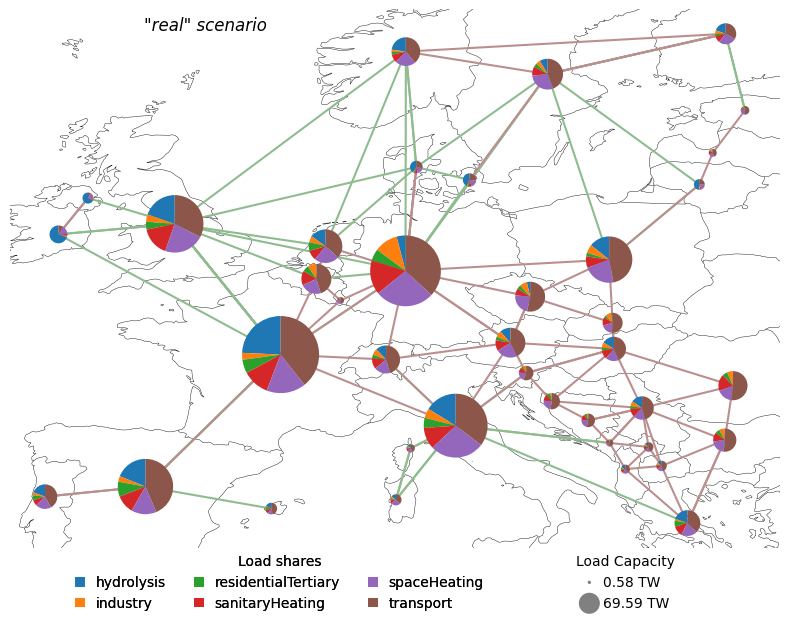

INFO:pypsa.io:Imported network zero_2050_full_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


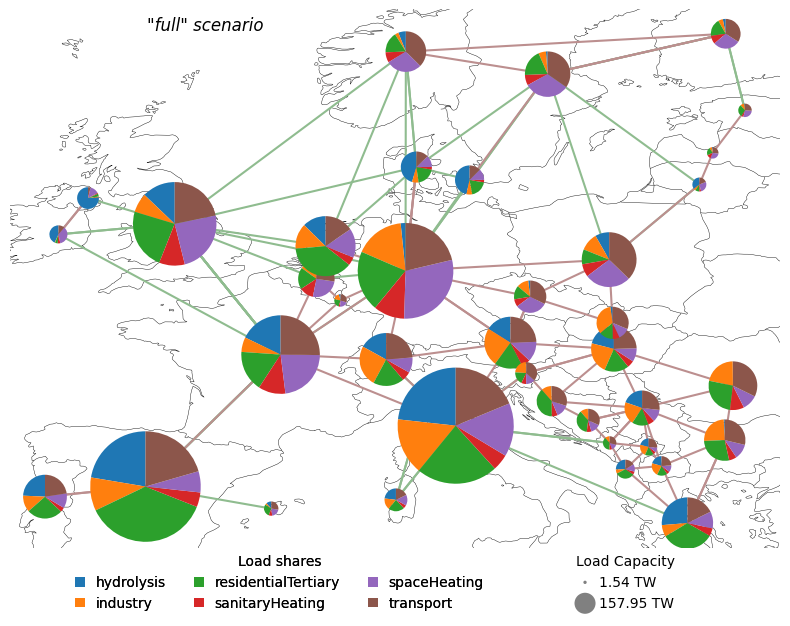

INFO:pypsa.io:Imported network zero_2050_max_fraction_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


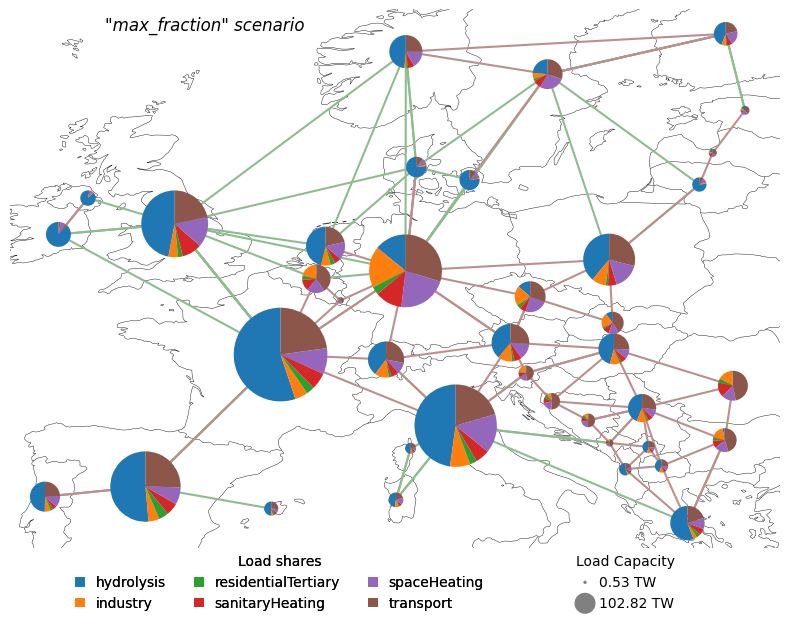

INFO:pypsa.io:Imported network zero_2050_tau_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


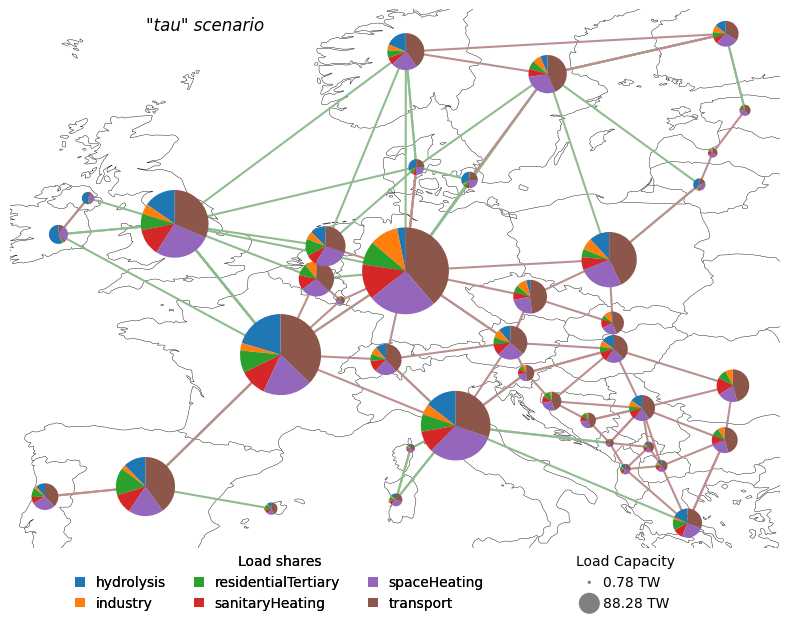

INFO:pypsa.io:Imported network zero_2050_flex_share_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


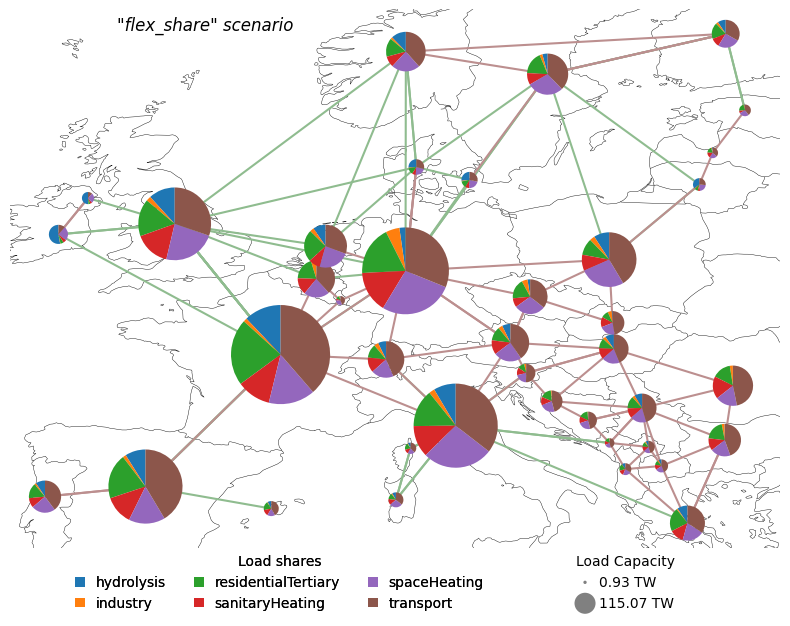

In [3]:
import re
def extract_bus_and_carrier(link_name):
    # Extract bus (country code + number) from the beginning of the string
    bus_match = re.match(r'([A-Z]{2}\d+\s\d+)', link_name)
    bus = bus_match.group(1) if bus_match else None
    
    # Extract carrier type by getting what's after "DSM_link_"
    carrier_match = re.search(r'DSM_link_(\w+)', link_name)
    carrier = carrier_match.group(1) if carrier_match else None
    
    return bus, carrier

for i, filename in enumerate(files):
    if "no" in filename:
        continue  # skip this file
    path = os.path.join(folder, filename)
    if os.path.exists(path):
        n = pypsa.Network(path)
        
        # Ensure p_nom_opt exists for storage_units
        if n.storage_units.empty or n.storage_units.p_nom_opt.isnull().all():
            print(f"No storage data found in {filename}")
            continue
        
        #links
        dsm_links = [l for l in n.links.index if "DSM" in l]
        links = n.links_t.p0[dsm_links][n.links_t.p0[dsm_links] > 0].sum()
        # Convert original series to a DataFrame for easier manipulation
        df = links.reset_index()
        df.columns = ['link', 'value']
        # Extract bus and carrier
        df[['bus', 'carrier']] = df['link'].apply(lambda x: pd.Series(extract_bus_and_carrier(x)))
        # Set up the MultiIndex and restructure the data
        results = df.set_index(['bus', 'carrier'])['value']

        source_colors = {
            "hydrolysis": "#1f77b4",  # A cool blue for hydrolysis
            "industry": "#ff7f0e",     # A vibrant orange for industry
            "residentialTertiary": "#2ca02c",  # A distinct green for residentialTertiary
            "sanitaryHeating": "#d62728",  # A strong red for sanitaryHeating
            "spaceHeating": "#9467bd",  # A purple for spaceHeating
            "transport": "#8c564b",  # A brown for transport
        }
        fig, ax = plt.subplots(subplot_kw={"projection":ccrs.PlateCarree()}, figsize=(8, 8))
        n.plot(ax=ax,
                    bus_sizes=results*5e-8,
                    bus_colors=source_colors,
                )

        # Legend for storage unit capacities
        grouped_dsm = results.groupby(['bus']).sum()
        sizes = [0.01,
                 0.4]
        labels = [f'{grouped_dsm.min()* 1e-6:.2f} TW', f'{grouped_dsm.max()* 1e-6:.2f} TW']

        pypsa.plot.add_legend_circles(ax, sizes, labels, srid=4326, patch_kw=dict(facecolor='grey'), legend_kw={
            'loc': 'center',
            'bbox_to_anchor': (0.8, -0.065), #side:(1.15, 0.65) #lower:(0.35, -0.065)
            'title': 'Load Capacity',
            'alignment': 'center',
            'frameon': False,
            'handlelength': 0.7,
            'ncol': 1
        })

        #valid_carriers = n.carriers.color[n.carriers.color != '']
        pypsa.plot.add_legend_patches(ax, colors=list(source_colors.values()), labels=list(source_colors.keys()), patch_kw={}, legend_kw={
            'loc': 'center',
            'bbox_to_anchor': (0.35, -0.065), #side:(1.15, 0.65) #lower:(0.35, -0.065)
            'title': 'Load shares',
            'alignment': 'center',
            'frameon': False,
            'handlelength': 0.7,
            'ncol': 3 #side:1 #lower:3
        })

        ax.text(
            -0.5, 63,
            f'"{mods[i]}" scenario',
            style='oblique',
            fontsize=12,
            ha='center',
            va='center',
            transform=ccrs.PlateCarree()
        )

        plt.tight_layout()
        plt.savefig(f'../figures/lower/pie-map_dsm_load_coverage_{filename}.pdf', bbox_inches='tight') #side:'../figures/pie-map_dsm_load_coverage_{filename}.pdf' #lower:'../figures/lower/pie-map_dsm_load_coverage_{filename}.pdf'
        plt.show()
    else:
        print(f"File not found: {filename}")

## Total system Costs

INFO:pypsa.io:Imported network zero_2050_no_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network zero_2050_real_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_full_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_max_fraction_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_tau_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_flex_share_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


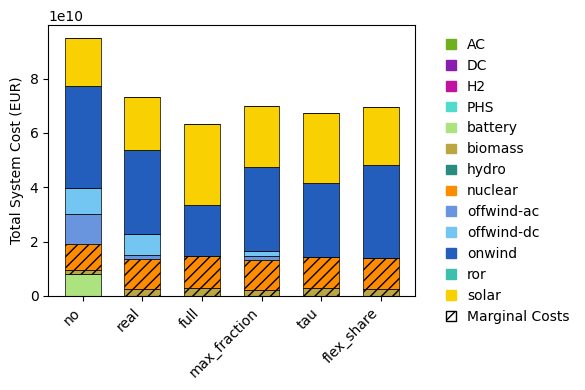

In [4]:
# Store data for all files
all_costs = []
nrFiles = 0

for filename in files:
    if filename.endswith('.nc'):
        n = pypsa.Network(os.path.join("../networks/solved/", filename))

        # Calculate costs
        storage_capital_costs = (n.storage_units['capital_cost'] * 
                                 (n.storage_units['p_nom_opt'] - n.storage_units['p_nom'])).groupby(n.storage_units['carrier']).sum()
        storage_marginal_costs = (n.storage_units['marginal_cost'] * 
                                  n.storage_units_t.p.sum(axis=0)).groupby(n.storage_units['carrier']).sum()
        generators_capital_costs = (n.generators['capital_cost'] * 
                                    (n.generators['p_nom_opt'] - n.generators['p_nom'])).groupby(n.generators['carrier']).sum()
        generators_marginal_costs = (n.generators['marginal_cost'] * 
                                     n.generators_t.p.sum(axis=0)).groupby(n.generators['carrier']).sum()
        AC_line_costs = n.lines.capital_cost.sum()
        DC_link_costs = n.links.capital_cost.sum()

        # Combine costs into a single DataFrame
        storage_costs = pd.DataFrame({
            'Capital': storage_capital_costs,
            'Marginal': storage_marginal_costs
        })
        generator_costs = pd.DataFrame({
            'Capital': generators_capital_costs,
            'Marginal': generators_marginal_costs
        })

        carrier_costs = (storage_costs.add(generator_costs, fill_value=0))
        carrier_costs.loc['AC'] = {'Capital': AC_line_costs, 'Marginal': 0}
        carrier_costs.loc['DC'] = {'Capital': DC_link_costs, 'Marginal': 0}

        # Add colors
        bar_colors = n.carriers['color']
        #extra_colors = pd.Series({'DC': 'red', 'AC': 'green'})
        #bar_colors = pd.concat([bar_colors, extra_colors])
        
        # Store costs and colors
        for carrier, row in carrier_costs.iterrows():
            for cost_type, value in row.items():
                all_costs.append({
                    'File': filename,
                    'Carrier': carrier,
                    'Cost Type': cost_type,
                    'Value': value,
                    'Color': bar_colors.get(carrier, 'gray'),
                    'Hatch': '///' if cost_type == 'Marginal' else None
                })
        
        nrFiles += 1

# Convert accumulated costs to a DataFrame
all_costs_df = pd.DataFrame(all_costs)

# Pivot the data for stacked bar chart
pivoted_costs = all_costs_df.pivot_table(
    index='File',
    columns=['Carrier', 'Cost Type'],
    values='Value',
    fill_value=0
)
# reindexing to match wanted order
pivoted_costs = pivoted_costs.loc[files]

# Plot stacked bars
fig, ax = plt.subplots(figsize=((1*nrFiles), 4)) #(0.9*nrFiles), 4.5)
bar_width = 0.6
x = np.arange(len(pivoted_costs.index))  # One bar per file

# Store unique legend handles for capital costs
legend_handles = {}
# Iterate through carriers and cost types for stacking
y_offset = np.zeros(len(pivoted_costs.index))
for i, ((carrier, cost_type), values) in enumerate(pivoted_costs.items()):
    # Determine color and hatching
    color = all_costs_df.loc[
        (all_costs_df['Carrier'] == carrier) & (all_costs_df['Cost Type'] == cost_type),
        'Color'
    ].iloc[0]
    hatch = '///' if cost_type == 'Marginal' else None
    
    # Plot bar segment
    ax.bar(x, values, bar_width, bottom=y_offset, label=f'{carrier} {cost_type}', color=color, hatch=hatch, edgecolor='black', linewidth=0.5)
    y_offset += values  # Update offset for stacking

    # Add legend handles for capital costs only
    if cost_type == 'Capital' and carrier not in legend_handles:
        legend_handles[carrier] = mpatches.Patch(color=color, label=f'{carrier}')

# Add single hatching legend for marginal costs
marginal_patch = mpatches.Patch(facecolor='white', edgecolor='black', hatch='///', label='Marginal Costs')

# Add labels and legend
#ax.set_title('Stacked Bar Chart of Carrier Costs by File with Custom Colors and Hatching')
ax.set_ylabel('Total System Cost (EUR)')
ax.set_xticks(x)
ax.set_xticklabels(mods, rotation=45, ha='right')

# Combine handles into the legend
ax.legend(handles=list(legend_handles.values()) + [marginal_patch], 
    loc='upper left',
    bbox_to_anchor=(1.05, 1),
    alignment='left',
    frameon=False,
    handlelength=0.7,)

plt.tight_layout()
#plt.show()
plt.savefig(f'../figures/total_system_cost_ALL.pdf', bbox_inches='tight')

## Capacity overview plot

INFO:pypsa.io:Imported network zero_2050_no_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network zero_2050_real_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_full_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_max_fraction_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_tau_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_flex_share_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


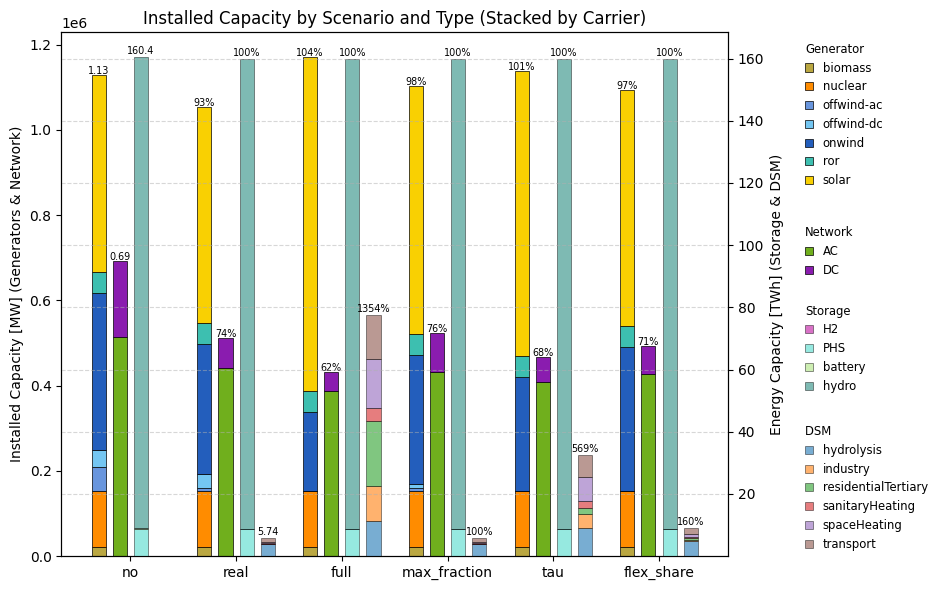

In [3]:
# Collect all capacity data
all_caps = []

for file, label in zip(files, mods):
    n = pypsa.Network(os.path.join("../networks/solved", file))

    # Generator
    gen_caps = n.generators.groupby("carrier")["p_nom_opt"].sum()
    gen_df = pd.DataFrame({"Scenario": label, "Type": "Generator", "Carrier": gen_caps.index, "Capacity": gen_caps.values})

    # Storage
    s_df = n.storage_units[["p_nom_opt", "max_hours", "carrier"]].copy()
    s_df["energy_MWh"] = s_df["p_nom_opt"] * s_df["max_hours"]
    storage_caps = s_df.groupby("carrier")["energy_MWh"].sum() / 1e6  # TWh
    storage_df = pd.DataFrame({"Scenario": label, "Type": "Storage", "Carrier": storage_caps.index, "Capacity": storage_caps.values})

    # DSM
    DSM_caps = n.stores.e_nom_opt.groupby(lambda x: x.split('store_')[-1]).sum() / 1e6  # TWh
    DSM_df = pd.DataFrame({"Scenario": label, "Type": "DSM", "Carrier": DSM_caps.index, "Capacity": DSM_caps.values})

    # Network
    link_caps = n.links.groupby("carrier")["p_nom_opt"].sum().loc[["DC"]]
    line_caps = n.lines.groupby("carrier")["s_nom_opt"].sum()
    net_caps = link_caps.add(line_caps, fill_value=0)
    network_df = pd.DataFrame({"Scenario": label, "Type": "Network", "Carrier": net_caps.index, "Capacity": net_caps.values})

    # Combine all
    all_caps.append(pd.concat([gen_df, network_df, storage_df, DSM_df]))

df = pd.concat(all_caps)

# Colors
carrier_colors = {c: col for c, col in n.carriers["color"].items()}
# Extended color list for new categories
extended_colors = {
    "hydrolysis": "#1f77b4",  # A cool blue for hydrolysis
    "industry": "#ff7f0e",     # A vibrant orange for industry
    "residentialTertiary": "#2ca02c",  # A distinct green for residentialTertiary
    "sanitaryHeating": "#d62728",  # A strong red for sanitaryHeating
    "spaceHeating": "#9467bd",  # A purple for spaceHeating
    "transport": "#8c564b",  # A brown for transport
    "residential": "#FFD700",  # gold for residential (adjusted)
    "commercial": "#FF69B4",   # hot pink for commercial
    "industrial": "#40E0D0",   # turquoise for industrial
}

# Updating the carrier colors with the new extended list
carrier_colors.update(extended_colors)


default_color = "gray"
df["Color"] = df["Carrier"].map(lambda x: carrier_colors.get(x, default_color))

# Split data
df_main = df[~df["Type"].isin(["Storage", "DSM"])]
df_secondary = df[df["Type"].isin(["Storage", "DSM"])]

pivot_main = df_main.pivot_table(index=["Scenario", "Type"], columns="Carrier", values="Capacity", fill_value=0)
pivot_secondary = df_secondary.pivot_table(index=["Scenario", "Type"], columns="Carrier", values="Capacity", fill_value=0)

# Plot
fig, ax = plt.subplots(figsize=(1.6 * len(mods), 6))
ax2 = ax.twinx()

scenarios = df["Scenario"].unique()
types = df["Type"].unique()
bar_width = 0.2
group_spacing = 1.5
intra_spacing = 0.1
x_ticks = []
x_tick_labels = []

base_value_main = [0] * len(types)
base_value_secondary = [0] * len(types)

# Collect legend info manually
legend_handles = {}
legend_labels = {}

# --- Main (left y-axis) ---
for i, scenario in enumerate(scenarios):
    for j, t in enumerate(types):
        x = i * group_spacing + j * (bar_width + intra_spacing)

        if (scenario, t) in pivot_main.index:
            row = pivot_main.loc[(scenario, t)]
            bottom = 0
            for carrier, value in row.items():
                if value > 0:
                    color = carrier_colors.get(carrier, default_color)
                    h = ax.bar(x, value, bar_width, bottom=bottom, color=color, edgecolor='black', linewidth=0.5)
                    bottom += value
                    legend_labels[carrier] = carrier
                    legend_handles[carrier] = h[0]

            if scenario == "no":
                base_value_main[j] = bottom
                ax.text(x, bottom + 3000, f"{round(bottom/1e6, 2)}", ha='center', fontsize='x-small', weight='ultralight')
            else:
                percentage = (bottom / base_value_main[j]) * 100 if base_value_main[j] > 0 else 0
                ax.text(x, bottom + 3000, f"{round(percentage)}%", ha='center', fontsize='x-small', weight='ultralight')

        # Only once per scenario
        if j == 0:
            # Compute the center of the group of bars for this scenario
            group_width = (len(types) - 1) * (bar_width + intra_spacing)
            center_x = x + group_width / 2
            x_ticks.append(center_x)
            x_tick_labels.append(scenario)

# --- Secondary (right y-axis) ---
for i, scenario in enumerate(scenarios):
    for j, t in enumerate(types):
        x = i * group_spacing + j * (bar_width + intra_spacing)

        if (scenario, t) in pivot_secondary.index:
            row = pivot_secondary.loc[(scenario, t)]
            bottom = 0
            for carrier, value in row.items():
                if value > 0:
                    color = carrier_colors.get(carrier, "lightblue")
                    h = ax2.bar(x, value, bar_width, bottom=bottom, color=color, edgecolor='black', linewidth=0.5, alpha=0.6)
                    bottom += value
                    legend_labels[carrier] = carrier
                    legend_handles[carrier] = h[0]

            if t == "DSM":
                if scenario == "real":
                    base_value_secondary[j] = bottom
                    ax2.text(x, bottom + 1, f"{round(bottom, 2)}", ha='center', fontsize='x-small', weight='ultralight')
                else:
                    percentage = (bottom / base_value_secondary[j]) * 100 if base_value_secondary[j] > 0 else 0
                    ax2.text(x, bottom + 1, f"{round(percentage)}%", ha='center', fontsize='x-small', weight='ultralight')
            else:
                if scenario == "no":
                    base_value_secondary[j] = bottom
                    ax2.text(x, bottom + 1, f"{round(bottom, 2)}", ha='center', fontsize='x-small', weight='ultralight')
                else:
                    percentage = (bottom / base_value_secondary[j]) * 100 if base_value_secondary[j] > 0 else 0
                    ax2.text(x, bottom + 1, f"{round(percentage)}%", ha='center', fontsize='x-small', weight='ultralight')


            # if scenario == "no":
            #     base_value_secondary[j] = bottom
            #     ax2.text(x, bottom + 1, f"{round(bottom, 2)}", ha='center', fontsize='x-small', weight='ultralight')
            # else:
            #     percentage = (bottom / base_value_secondary[j]) * 100 if base_value_secondary[j] > 0 else 0
            #     ax2.text(x, bottom + 1, f"{round(percentage)}%", ha='center', fontsize='x-small', weight='ultralight')

# Labels and layout
ax.set_ylabel("Installed Capacity [MW] (Generators & Network)")
ax2.set_ylabel("Energy Capacity [TWh] (Storage & DSM)")
ax.set_title("Installed Capacity by Scenario and Type (Stacked by Carrier)")
ax.set_xticks(x_ticks)
ax.set_xticklabels(x_tick_labels)

# --- Legends ---
carrier_to_type = df.drop_duplicates(subset=["Carrier", "Type"]).set_index("Carrier")["Type"].to_dict()

# Sort carriers into type buckets
type_buckets = {t: {} for t in types}
for label, handle in legend_handles.items():
    type_of_carrier = carrier_to_type.get(label)
    if type_of_carrier in type_buckets:
        type_buckets[type_of_carrier][label] = handle

legend_offset = 1.1
y_start = 1  # Top of plot
line_height = 0.04
cumulative_offset = 0

for t in types:
    sub_handles = list(type_buckets[t].values())
    sub_labels = list(type_buckets[t].keys())
    if not sub_handles:
        continue

    legend_height = len(sub_labels) * line_height + 0.07 #0.1
    if t != types[-1]:
        legend = ax.legend(
            sub_handles,
            sub_labels,
            title=t,
            loc="upper left",
            bbox_to_anchor=(legend_offset, y_start - cumulative_offset),
            bbox_transform=ax.transAxes,
            alignment='left',
            frameon=False,
            handlelength=0.7,
            title_fontsize='small', 
            fontsize='small',
        )
        ax.add_artist(legend)
    else:
        ax.legend(
            sub_handles,
            sub_labels,
            title=f"{t}               ",
            loc="upper left",
            bbox_to_anchor=(legend_offset, y_start - cumulative_offset),
            bbox_transform=ax.transAxes,
            alignment='left',
            frameon=False,
            handlelength=0.7,
            title_fontsize='small', 
            fontsize='small',
        )
    cumulative_offset += legend_height

plt.tight_layout()
plt.grid(True, axis="y", linestyle="--", alpha=0.5)
#plt.show()
plt.savefig(f'../figures/total_system_capacities_ALL.pdf', bbox_inches='tight')


## Total & Sectoral Demand plot

INFO:pypsa.io:Imported network zero_2050_no_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


<Figure size 700x400 with 0 Axes>

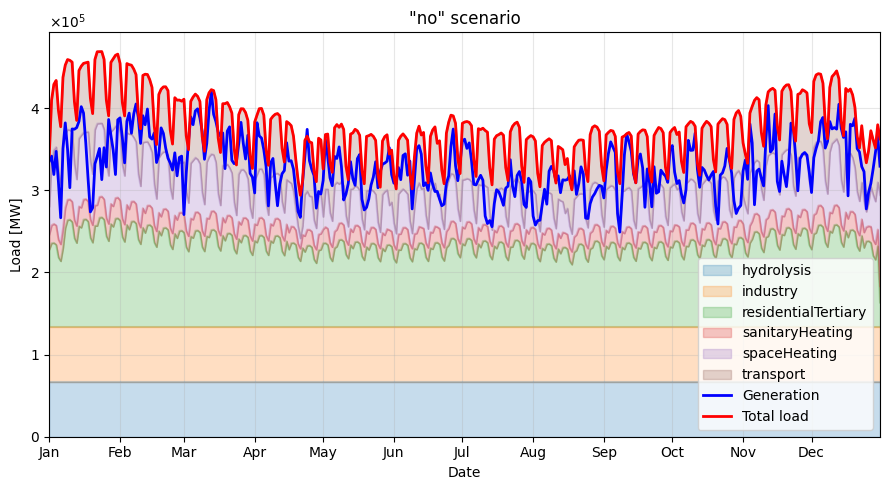

In [ ]:
DSM_loads = pd.read_pickle(f'../data/zero_2050_full/DSM_loads.pkl')
mean_DSM_loads = DSM_loads.groupby(DSM_loads.index.date).mean()
category_means = mean_DSM_loads.groupby(level='Category', axis=1).sum()

for i, filename in enumerate(files):
    if "no" not in filename:
        continue  # skip all except the "no" case
    path = os.path.join(folder, filename)
    if os.path.exists(path):
        n = pypsa.Network(path)
        
        # Set up the figure size
        plt.figure(figsize=(7, 4))

        generation = n.generators_t.p.sum(axis=1).resample('1D').mean()
        #load = n.loads_t.p_set.sum(axis=1).resample('1D').mean()
        load = DSM_loads.sum(axis=1).resample('1D').mean()

        # 2. Stacked area plot - shows both individual and cumulative contributions
        category_means.plot.area(figsize=(9, 5), alpha=0.25, stacked=True)
        # 3. Plot generation as a line
        plt.plot(generation.index, generation, color='blue', label='Generation', linewidth=2)
        plt.plot(load.index, load, color="red", label="Total load", linewidth=2)
        plt.title(f'"{mods[i]}" scenario')
        plt.ylabel('Load [MW]')
        plt.xlabel('Date')
        plt.grid(True, alpha=0.3)
        plt.legend(loc='lower right') #title='Sector'

        ax = plt.gca()
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%b'))
        plt.gca().yaxis.set_major_formatter(ScalarFormatter(useMathText=True))
        plt.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))
        plt.gca().margins(x=0)
        plt.tight_layout()
        plt.savefig(f'../figures/total_load_{filename}.pdf', bbox_inches='tight')
        plt.show()
    else:
        print(f"File not found: {filename}")

## HEATMAP STORE UTILIZATION

In [6]:
def create_e_max_pu(e_min_pu: pd.DataFrame, e_max_pu: pd.DataFrame) -> pd.DataFrame:
    # Step 1: Identify hydrolysis and industry columns
    hydrolysis_industry_cols = [col for col in e_min_pu.columns 
                                if "hydrolysis" in col or "industry" in col]

    # Step 2: Set those columns to 1.0 in e_max_pu
    for col in hydrolysis_industry_cols:
        e_max_pu[col] = 1.0

    # Step 3: Helper to extract node prefix
    def get_node_prefix(col_name):
        match = re.search(r'^([A-Z]{2}\d+\s+\d+)_', col_name)
        return match.group(1) if match else None

    # Step 4: Group columns by prefix
    node_cols = {}
    for col in e_min_pu.columns:
        prefix = get_node_prefix(col)
        if prefix not in node_cols:
            node_cols[prefix] = []
        node_cols[prefix].append(col)

    # Step 5: Sort columns by node and sector
    ordered_cols = []
    for prefix in sorted(node_cols.keys()):
        ordered_cols.extend(sorted(node_cols[prefix]))

    # Step 6: Ensure 'snapshot' stays first if present
    if 'snapshot' in e_min_pu.columns:
        ordered_cols = ['snapshot'] + [col for col in ordered_cols if col != 'snapshot']

    # Step 7: Reorder e_max_pu columns
    e_max_pu = e_max_pu[ordered_cols]

    return e_max_pu
#e_max_pu = create_e_max_pu(n.stores_t.e_min_pu.copy(), n.stores_t.e_max_pu.copy())

INFO:pypsa.io:Imported network zero_2050_real_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


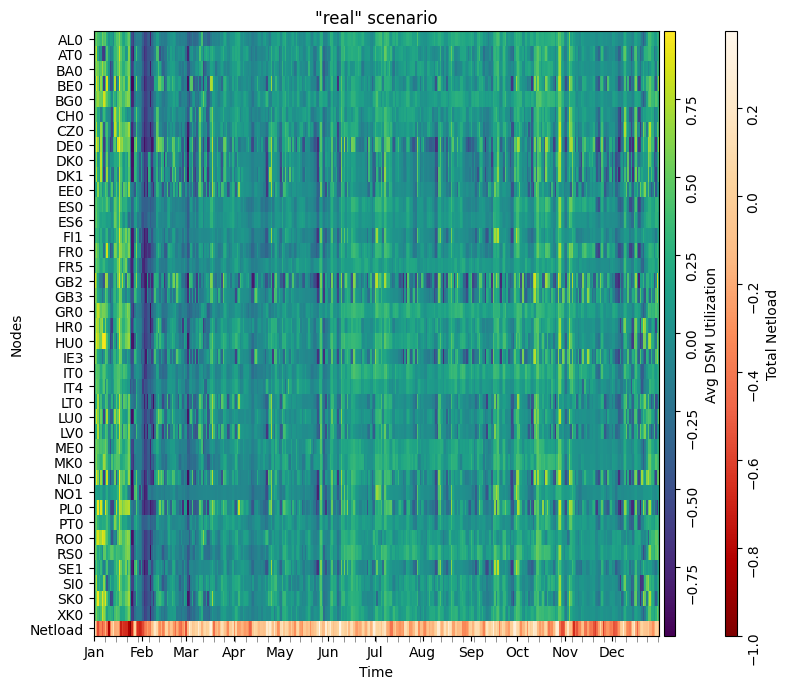

INFO:pypsa.io:Imported network zero_2050_full_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


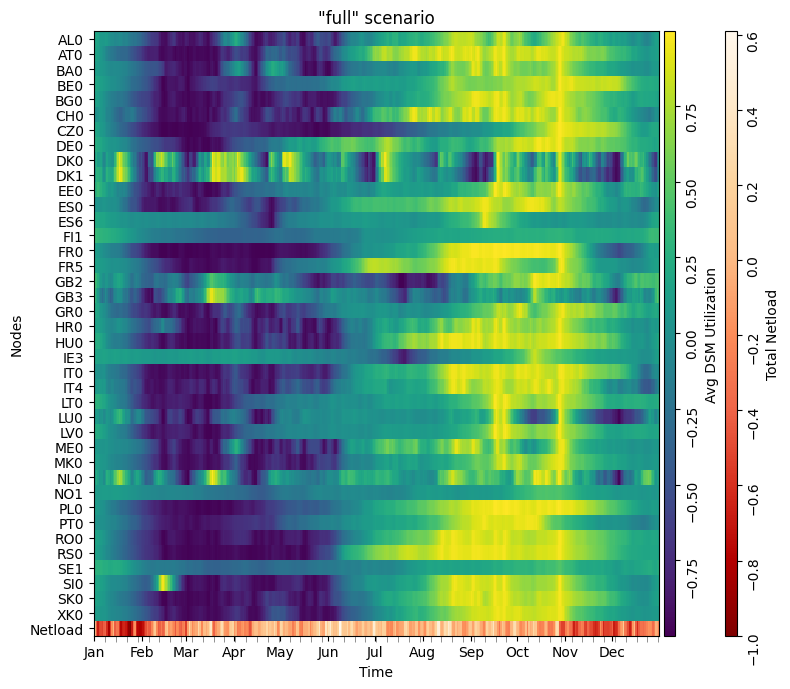

INFO:pypsa.io:Imported network zero_2050_max_fraction_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


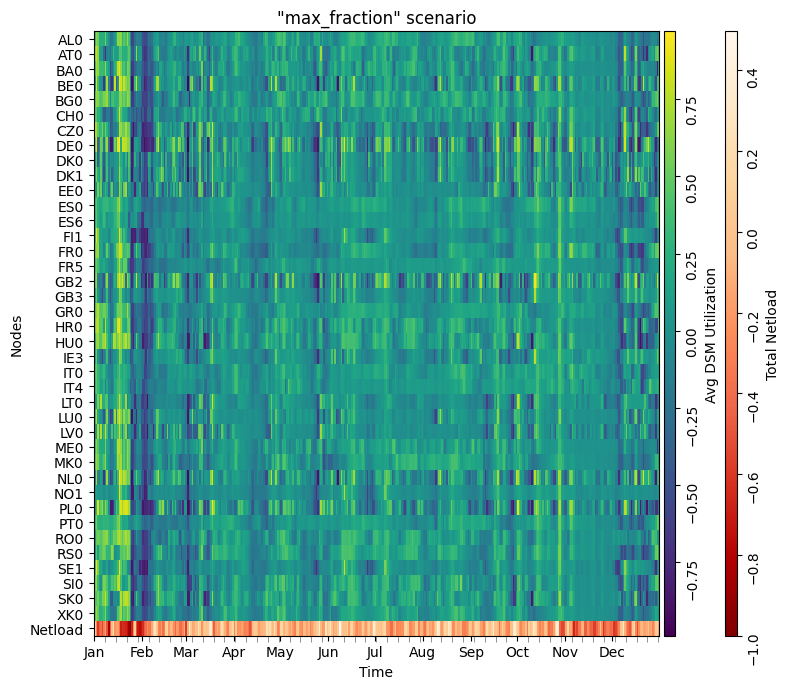

INFO:pypsa.io:Imported network zero_2050_tau_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


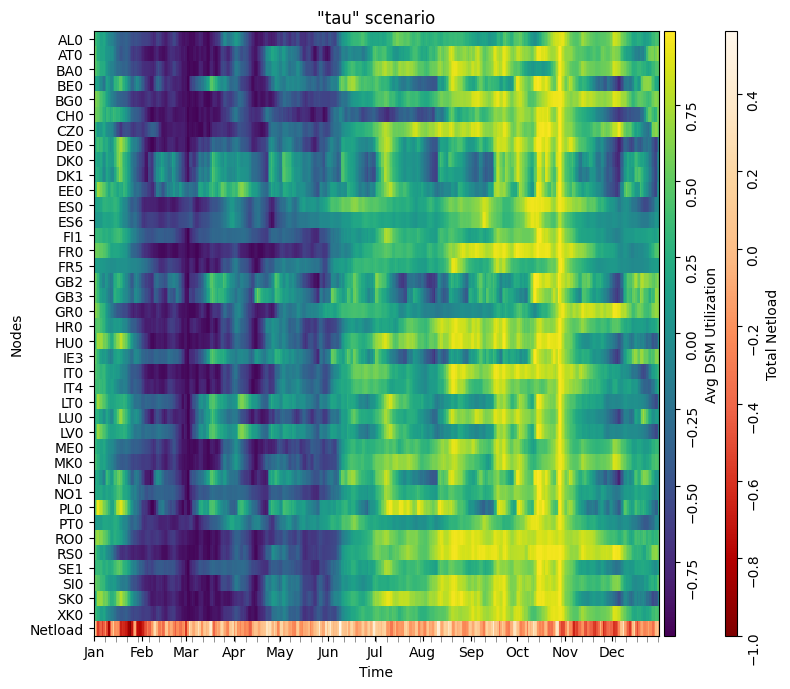

INFO:pypsa.io:Imported network zero_2050_flex_share_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


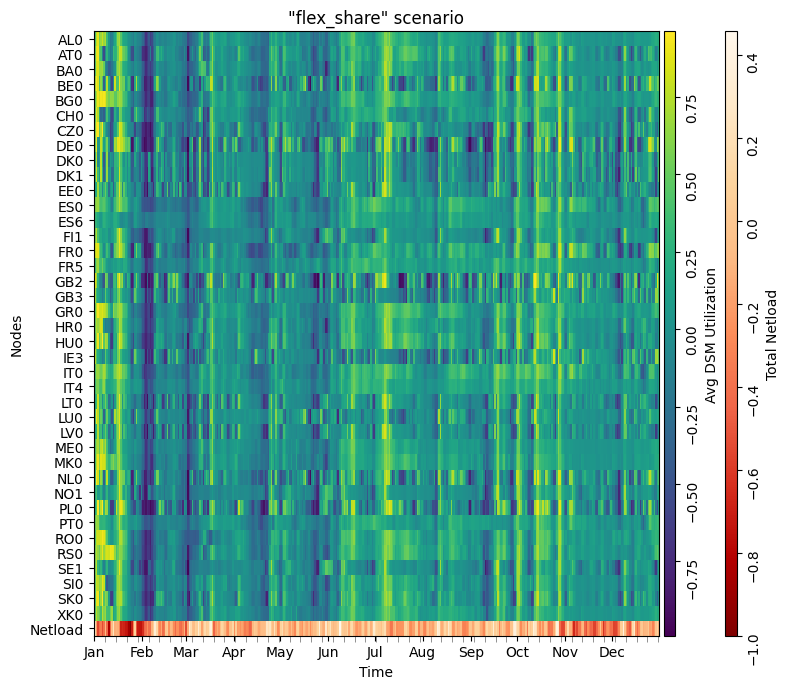

In [ ]:
for i, filename in enumerate(files):
    if "no" in filename:
        continue # skip this file
    
    path = os.path.join(folder, filename)
    if os.path.exists(path):
        n = pypsa.Network(path)
        e_max_pu = create_e_max_pu(n.stores_t.e_min_pu.copy(), n.stores_t.e_max_pu.copy())
        
        # Extract raw power flow data
        stores = n.stores_t.e.resample('1D').mean()
        
        # Compute normalization denominators
        e_max = (e_max_pu.mul(n.stores.e_nom, axis='columns')).resample('1D').mean()
        e_min = (n.stores_t.e_min_pu.mul(n.stores.e_nom, axis='columns')).resample('1D').mean()
        
        # Normalize positive and negative flows separately
        pos_util = stores.where(stores > 0).div(e_max, axis='columns')
        neg_util = -stores.where(stores < 0).div(e_min, axis='columns')
        
        # Fill NaNs with 0 and combine
        utilization = pos_util.fillna(0) + neg_util.fillna(0)
        daily_util = utilization
        df = daily_util
        
        # Remove column name if it exists
        df.columns.name = None 
        
        # Step 1: Extract node names
        node_groups = df.columns.to_series().groupby(lambda x: x.split(' ')[0]).groups
        
        # Step 2: Average columns for each node
        avg_df = pd.DataFrame(index=df.index)
        for node, cols in node_groups.items():
            avg_df[node] = df[cols].mean(axis=1)
        
        # Add total netload as last row:
        netload = (n.generators_t.p.sum(axis=1) - n.loads_t.p_set.sum(axis=1)).resample('1D').sum()
        norm_netload = netload / netload.abs().max()
        avg_df['Netload'] = norm_netload
        
        # Transpose the DataFrame for correct orientation
        df_t = avg_df.T
        
        # Create figure and axis
        fig, ax = plt.subplots(figsize=(8, 7))
        
        # Create a mask for the netload row
        mask_other = np.zeros_like(df_t.values, dtype=bool)
        mask_other[-1, :] = True  # Mask the last row (Netload)
        
        mask_netload = ~mask_other  # Inverse mask for netload only
        
        # Create masked arrays
        data_other = np.ma.masked_array(df_t.values, mask=mask_other)
        data_netload = np.ma.masked_array(df_t.values, mask=mask_netload)
        
        # Plot the main heatmap (all except netload)
        im1 = ax.imshow(data_other, aspect='auto', cmap='viridis', interpolation='nearest')
        
        # Plot the netload with a different colormap
        im2 = ax.imshow(data_netload, aspect='auto', cmap="OrRd_r", interpolation='nearest')
        
        # Add colorbars
        divider = make_axes_locatable(ax)
        cax1 = divider.append_axes("right", size="2%", pad=0.05)
        cax2 = divider.append_axes("right", size="2%", pad=0.5)
        
        cbar1 = plt.colorbar(im1, cax=cax1, label='Avg DSM Utilization')
        cbar2 = plt.colorbar(im2, cax=cax2, label='Total Netload')
        
        # Make the tick labels vertical
        cbar1.ax.tick_params(axis='y', rotation=90)
        cbar2.ax.tick_params(axis='y', rotation=90)
        
        # Set major ticks at the first of each month
        major_ticks = [i for i, date in enumerate(df_t.columns) 
                       if date.day == 1 and (i == 0 or date.month != df_t.columns[i-1].month)]
        major_labels = [date.strftime('%b') for i, date in enumerate(df_t.columns) 
                        if date.day == 1 and (i == 0 or date.month != df_t.columns[i-1].month)]
        
        # Set minor ticks (every 7 days)
        minor_ticks = list(range(0, len(df_t.columns), 7))
        minor_ticks = [tick for tick in minor_ticks if tick not in major_ticks]
        
        # Apply the ticks
        ax.set_xticks(major_ticks)
        ax.set_xticklabels(major_labels)
        ax.set_xticks(minor_ticks, minor=True)
        ax.tick_params(axis='x', which='minor', length=4, color='gray')
        
        # Set y-tick labels
        ax.set_yticks(range(len(df_t.index)))
        ax.set_yticklabels(df_t.index)
        
        # Set title and labels on the main axis (not using plt.title/xlabel/ylabel)
        ax.set_title(f'"{mods[i]}" scenario')
        ax.set_ylabel('Nodes')
        ax.set_xlabel('Time')
        
        plt.tight_layout()
        plt.savefig(f'../figures/heatmap_util_{filename}.pdf', bbox_inches='tight')
        plt.show()
    else:
        print(f"File not found: {filename}")

## DSM Store Utilization Time Series

INFO:pypsa.io:Imported network zero_2050_real_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_full_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_max_fraction_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_tau_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network zero_2050_flex_share_solved.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


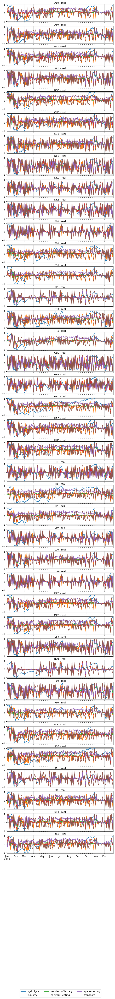

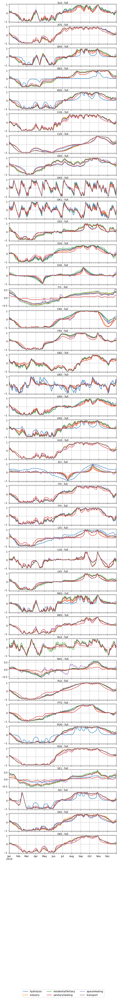

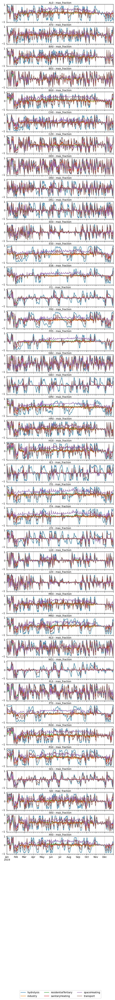

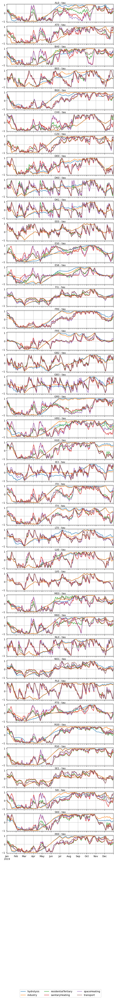

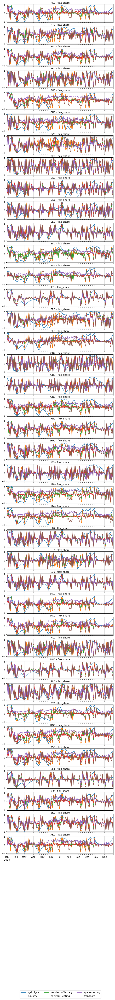

In [10]:
labels = ['hydrolysis', 'industry', 'residentialTertiary', 'sanitaryHeating', 'spaceHeating', 'transport']

for i, filename in enumerate(files):
    if "no" in filename:
        continue # skip this file
    
    path = os.path.join(folder, filename)
    if os.path.exists(path):
        n = pypsa.Network(path)
        e_max_pu = create_e_max_pu(n.stores_t.e_min_pu.copy(), n.stores_t.e_max_pu.copy())

        # Extract raw power flow data
        stores = n.stores_t.e.resample('1D').mean()
        
        # Compute normalization denominators
        e_max = (e_max_pu.mul(n.stores.e_nom, axis='columns')).resample('1D').mean()
        e_min = (n.stores_t.e_min_pu.mul(n.stores.e_nom, axis='columns')).resample('1D').mean()

        # Normalize positive and negative flows separately
        pos_util = stores.where(stores > 0).div(e_max, axis='columns')
        neg_util = -stores.where(stores < 0).div(e_min, axis='columns')
        # Fill NaNs with 0 and combine
        utilization = pos_util.fillna(0) + neg_util.fillna(0)
        daily_util = utilization

        prefixes = [bus for bus in n.buses.index if "DSM" not in bus]

        # Set up subplots — one row per prefix
        fig, axes = plt.subplots(len(prefixes), 1, figsize=(8, 2 * len(prefixes)), sharex=True)

        for j, prefix in enumerate(prefixes):
            selected_columns = [col for col in daily_util.columns if col.startswith(prefix)]
            df_subset = daily_util[selected_columns]

            df_subset.plot(ax=axes[j], legend=False)
            axes[j].set_title(f"{prefix.split()[0]} - {mods[i]}", pad=-10, fontsize=10) #Daily avg. DSM Store Utilization - 
            #axes[j].set_ylabel("Utilization")
            axes[j].grid(True)

        # Add a common legend to the figure
        fig.legend(labels=labels, bbox_to_anchor=(0.82, 0.15), ncol=3) #bbox_to_anchor=(0.875, 0), ncol=3) bbox_to_anchor=(1.25, 0.75), ncol=1)
        plt.subplots_adjust(bottom=0.25)
        plt.xlabel(" ")
        #plt.tight_layout()
        plt.savefig(f'../figures/store_util_{filename}.pdf', bbox_inches='tight')
        # plt.show()

## Load Profiles Plot

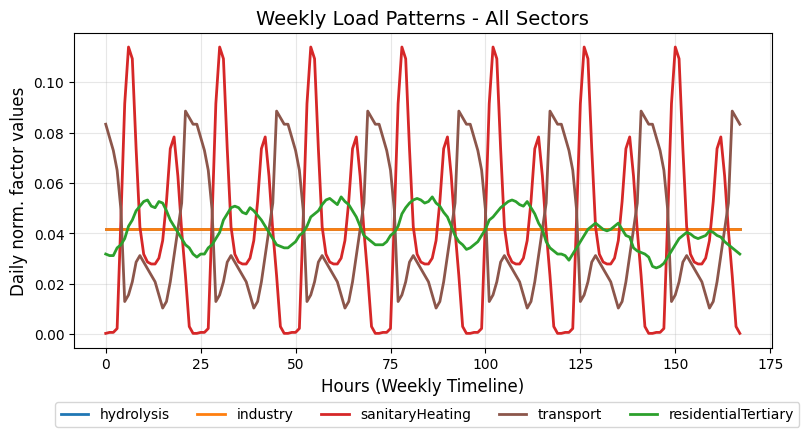

In [ ]:
data = {
    'hydrolysis': np.array([0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667]),
    'industry': np.array([0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667, 0.04166667]),
    'residentialTertiary': np.array([0.00455023, 0.00446272, 0.00446272, 0.00490025, 0.00507525, 0.00542527, 0.00612531, 0.00647532, 0.00700035, 0.00726286, 0.00752538, 0.00761288, 0.00726286, 0.00717536, 0.00752538, 0.00743787, 0.00700035, 0.00647532, 0.00612531, 0.00577529, 0.00542527, 0.00507525, 0.00490025, 0.00455023, 0.00437522, 0.00455023, 0.00455023, 0.00490025, 0.00507525, 0.00542527, 0.00577529, 0.00647532, 0.00682534, 0.00717536, 0.00726286, 0.00717536, 0.00691285, 0.00682534, 0.00717536, 0.00700035, 0.00673784, 0.00647532, 0.00612531, 0.00577529, 0.00542527, 0.00507525, 0.00498775, 0.00490025, 0.00490025, 0.00507525, 0.00525026, 0.00560028, 0.00577529, 0.00612531, 0.00665033, 0.00682534, 0.00700035, 0.00735037, 0.00761288, 0.00770039, 0.00752538, 0.00735037, 0.00778789, 0.00752538, 0.00735037, 0.00700035, 0.00665033, 0.00612531, 0.00560028, 0.00542527, 0.00525026, 0.00507525, 0.00507525, 0.00507525, 0.00525026, 0.00560028, 0.00577529, 0.00612531, 0.00682534, 0.00717536, 0.00743787, 0.00761288, 0.00770039, 0.00761288, 0.00743787, 0.00752538, 0.00778789, 0.00743787, 0.00726286, 0.00691285, 0.00665033, 0.00612531, 0.00560028, 0.00525026, 0.00507525, 0.00481274, 0.00490025, 0.00507525, 0.00525026, 0.00560028, 0.0059503 , 0.00647532, 0.00665033, 0.00691285, 0.00717536, 0.00735037, 0.00752538, 0.00761288, 0.00752538, 0.00735037, 0.00726286, 0.00752538, 0.00717536, 0.00682534, 0.00630032, 0.0059503 , 0.00525026, 0.00490025, 0.00472524, 0.00455023, 0.00455023, 0.00446272, 0.00420021, 0.00455023, 0.00490025, 0.00525026, 0.00560028, 0.0059503 , 0.00612531, 0.00630032, 0.00612531, 0.0059503 , 0.00586279, 0.0059503 , 0.00612531, 0.00630032, 0.0059503 , 0.00560028, 0.00551278, 0.00490025, 0.00472524, 0.00463773, 0.00455023, 0.00437522, 0.00385019, 0.00376269, 0.00385019, 0.0040252 , 0.00437522, 0.00472524, 0.00507525, 0.00542527, 0.00560028, 0.00577529, 0.00568778, 0.00551278, 0.00542527, 0.00551278, 0.00560028, 0.00586279, 0.00577529, 0.00560028, 0.00551278, 0.00525026, 0.00507525, 0.00490025, 0.00472524, 0.00455023]),
    'sanitaryHeating': np.array([0.0003876 , 0.00077519, 0.00077519, 0.00232558, 0.04573643, 0.09147287, 0.11395349, 0.10930233, 0.07364341, 0.04263566, 0.03178295, 0.02868217, 0.02790698, 0.02790698, 0.03023256, 0.0372093 , 0.05271318, 0.07364341, 0.07829457, 0.0627907 , 0.04108527, 0.02325581, 0.00310078, 0.0003876 ]),
    'transport': np.array([0.08333333, 0.078125 , 0.07291667, 0.06510417, 0.04947917, 0.01302083, 0.015625 , 0.02083333, 0.02864583, 0.03125 , 0.02864583, 0.02604167, 0.0234375 , 0.02083333, 0.015625 , 0.01041667, 0.01302083, 0.02083333, 0.03125 , 0.04166667, 0.05208333, 0.08854167, 0.0859375 , 0.08333333])
}

# Create time axes
# For daily data (24 points): hours 0-23
hours_daily = np.arange(24)

# For weekly data (168 points): hours 0-167 (7 days * 24 hours)
hours_weekly = np.arange(168)

# Create the plot
plt.figure(figsize=(9, 5))

# Plot daily data series (repeated for 7 days to show weekly pattern)
daily_series = ['hydrolysis', 'industry', 'sanitaryHeating', 'transport']
colors = ["#1f77b4", "#ff7f0e", "#d62728", "#8c564b", "#2ca02c"]

for i, series_name in enumerate(daily_series):
    series_data = data[series_name]
    # Repeat daily pattern for 7 days
    weekly_pattern = np.tile(series_data, 7)
    plt.plot(hours_weekly, weekly_pattern, label=series_name, color=colors[i], linewidth=2)

# Plot the weekly residential tertiary data
plt.plot(hours_weekly, data['residentialTertiary']*7, 
         label='residentialTertiary', color=colors[4], linewidth=2)

# Customize the plot
plt.xlabel('Hours (Weekly Timeline)', fontsize=12)
plt.ylabel('Daily norm. factor values', fontsize=12)
plt.title('Weekly Load Patterns - All Sectors', fontsize=14) #, fontweight='bold')
plt.legend(bbox_to_anchor=(1.05, -0.15), ncol=5)
plt.subplots_adjust(bottom=0.25)
plt.grid(True, alpha=0.3)
plt.savefig("../figures/loadprofiles.pdf")